# 28&Me Gradients

## Load packages

In [1]:
# General
import os
import sys
import numpy as np
import pandas as pd
import csv
import math
from math import isnan
import statistics
import pingouin as pg
import pickle

# Computing / Analyses
import scipy.io  # loadmat
from scipy import stats
import sklearn 
from brainstat.stats.terms import FixedEffect
from brainstat.stats.SLM import SLM
from statsmodels.stats.multitest import fdrcorrection # does not yield exactly the same FDR correction as R but the same up to 14th decimal place so good enough
import statsmodels.regression.mixed_linear_model as sm

# Visualisation
import matplotlib.pyplot as plt 
import seaborn as sns
import vtk
from IPython.display import display
import matplotlib.collections as clt
import ptitprince as pt

# Neuroimaging
import nibabel
import nilearn
from brainstat.datasets import fetch_parcellation
from enigmatoolbox.permutation_testing import spin_test, shuf_test

# Gradients
import brainspace
from brainspace.datasets import load_parcellation, load_conte69
from brainspace.plotting import plot_hemispheres
from brainspace.gradient import GradientMaps
from brainspace.utils.parcellation import map_to_labels

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/outdated/utils.py:14: OutdatedPackageWarning: The package pingouin is out of date. Your version is 0.5.2, the latest is 0.5.3.
Set the environment variable OUTDATED_IGNORE=1 to disable these warnings.
  return warn(


## Define directories

In [2]:
codedir = os.path.abspath('')  # obtain current direction from which script is runnning

datadir = '/data/p_02667/28Me/data/'

resdir = '/data/p_02667/28Me/results/'
resdir_fig = resdir + 'figures/'

## Import functions

In [3]:
%run '/data/p_02667/sex_diff_gradients/scripts/p1_myfunctions.ipynb'

# Data

## Import the Yeo 7 network coding for the Schaefer 400 parcellation scheme 

(i.e., which network each parcel belongs to)

In [4]:
# labels: 1=visual, 2=sensory motor, 3=dorsal attention, 4=ventral attention, 5=limbic, 6=fronto parietal, 7= DMN

yeo7_networks_array = np.genfromtxt(datadir+'yeo_7.csv', delimiter=',', skip_header=0)

In [5]:
# Sofie's 17 to 7 network conversion for Schaefer 400 (17 network) parcel order

yeo_17_2_7 = np.genfromtxt(datadir+'yeo_17_2_7.csv', delimiter=',')

### Define custom yeo 7 colormap

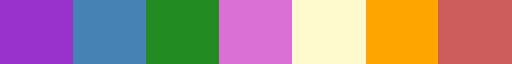

In [6]:
from matplotlib.colors import ListedColormap

# define custom colormap using color names (in order of corresponding networks: 1 visual, 2 sensorimotor, 3 dorsal attention, 4 ventral attention, 5 limbic, 6 fronto parietal, 7 DMN)
colors_yeo7 = ['darkorchid', 'steelblue', 'forestgreen', 'orchid', 'lemonchiffon', 'orange',  'indianred']

yeo7_colormap = ListedColormap(colors_yeo7, 'custom_colormap')

yeo7_colormap

### Plot on hemispheres

#### Schaefer 400 7 networks

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:292: UserWarning: Support for interactive mode is only provided for a single renderer: 'nrow=1' and 'ncol=1'. Setting 'interactive=False'
  warnings.warn("Support for interactive mode is only provided for "


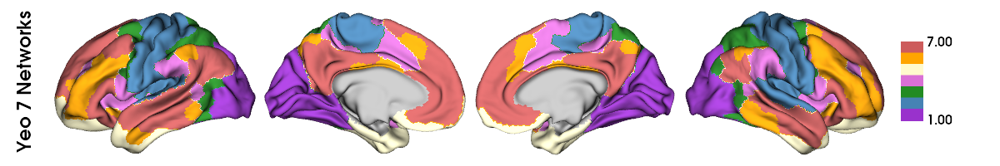

In [7]:
# defining labeling scheme and mask
labeling = load_parcellation('schaefer', scale=400, join=True)
surf_lh, surf_rh = load_conte69()

mask = labeling != 0

networks = map_to_labels(yeo7_networks_array, labeling, mask=mask, fill=np.nan) 

plot_hemispheres(surf_lh, surf_rh, 
                 array_name=networks, 
                 embed_nb = True, 
                 size=(1200, 200), 
                 cmap= yeo7_colormap, 
                 color_bar=True, 
                 nan_color = (0.7, 0.7, 0.7, 1),
                 label_text=['Yeo 7 Networks'], 
                 zoom=1.55,
                 screenshot=False,
                 filename=resdir_fig+'plotted_hemispheres_yeo7.png')

#### Schaefer 400 17 to 7 networks, plotted in fs5 space

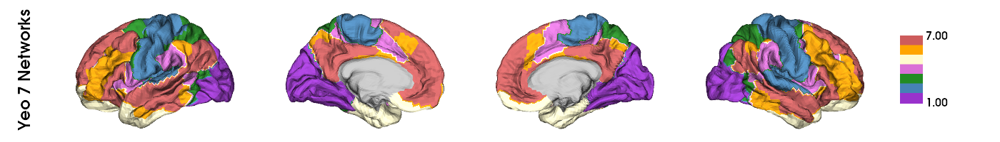

In [8]:
# convert network labels to fs5 space
yeo_17_2_7_fs5 = schaefer400_to_fs5(schaefer400_data = yeo_17_2_7, seven_networks=False)


# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = yeo_17_2_7_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = yeo7_colormap, 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["Yeo 7 Networks"],
    zoom = 1.45)

In [9]:
# making an array with yeo network labels (names instead of numbers)
yeo_17_2_7_networks_array_labels = []

for i in yeo_17_2_7:
    if i == 1:
        yeo_17_2_7_networks_array_labels.append('visual')
    elif i == 2:
        yeo_17_2_7_networks_array_labels.append('sensory motor')
    elif i == 3:
        yeo_17_2_7_networks_array_labels.append('dorsal attention')
    elif i == 4:
        yeo_17_2_7_networks_array_labels.append('ventral attention')
    elif i == 5:
        yeo_17_2_7_networks_array_labels.append('limbic')
    elif i == 6:
        yeo_17_2_7_networks_array_labels.append('fronto parietal')
    elif i == 7:
        yeo_17_2_7_networks_array_labels.append('DMN')

yeo_17_2_7_networks_array_labels = np.asarray(yeo_17_2_7_networks_array_labels)

This palette is to be used for every time that Yeo networks are displayed in color (except (a) for showing the networks plotted on the hemispheres - this dictionary doesn't work as cmap for plot_hemispheres; (b) the pie charts - dictionary format not recognized)

In [10]:
# original Yeo network colors
palette_labeled_networks = {'DMN': 'indianred',  
                            'dorsal attention' : 'forestgreen',  
                            'fronto parietal' : 'orange',  
                            'limbic' : 'lemonchiffon',  
                            'sensory motor' : 'steelblue',
                            'ventral attention' : 'orchid', 
                            'visual' : 'darkorchid'} 

In [11]:
network_names = ["visual", "sensory motor", "dorsal attention", "ventral attention", "limbic", "fronto parietal", "DMN"]

print("Number of parcels in each Yeo network:")
for i in range(len(network_names)):
    print(f"- {network_names[i]}: {yeo_17_2_7_networks_array_labels.tolist().count(network_names[i])}")

Number of parcels in each Yeo network:
- visual: 61
- sensory motor: 77
- dorsal attention: 46
- ventral attention: 47
- limbic: 26
- fronto parietal: 53
- DMN: 90


## 28&Me functional matrices

In [12]:
path_list = os.listdir(datadir + 'coherence/coherence/28andMe/noGSR/')
path_list.sort()

In [13]:
fc_matrices = []

for file in path_list:
    
    # taking the FC matrices from the mat file (indexing within, then only taking the first 400 rows and columns because FC matrices include 15 additional subcortical areas
    extracted_mat = scipy.io.loadmat(datadir + 'coherence/coherence/28andMe/noGSR/'+file)['coherence'][0][0][0][0][0][0][:400,:400]
    
    # append the extracted mat file to list containing fc matrices
    fc_matrices.append(extracted_mat)
    
fc_matrices = np.array(fc_matrices)

In [14]:
fc_matrices.shape

(30, 400, 400)

## 28&OC functional matrices

In [15]:
path_list = os.listdir(datadir + 'coherence/coherence/28andOC/noGSR/')
path_list.sort()

In [16]:
fc_matrices_OC = []

for file in path_list:
    
    # taking the FC matrices from the mat file (indexing within, then only taking the first 400 rows and columns because FC matrices include 15 additional subcortical areas
    extracted_mat = scipy.io.loadmat(datadir + 'coherence/coherence/28andOC/noGSR/'+file)['coherence'][0][0][0][0][0][0][:400,:400]
    
    # append the extracted mat file to list containing fc matrices
    fc_matrices_OC.append(extracted_mat)
    
fc_matrices_OC = np.array(fc_matrices_OC)

In [17]:
fc_matrices_OC.shape

(30, 400, 400)

## 28&He functional matrices

In [18]:
path_list = os.listdir(datadir + '28andHe_Coherence_withoutGSR/')
path_list.sort()

In [19]:
fc_matrices_He = []

for file in path_list:
    
    # taking the FC matrices from the mat file (indexing within, then only taking the first 400 rows and columns because FC matrices include 15 additional subcortical areas
    extracted_mat = scipy.io.loadmat(datadir + '28andHe_Coherence_withoutGSR/'+file)['coherence'][0][0][0][0][0][0][:400,:400]
    
    # append the extracted mat file to list containing fc matrices
    fc_matrices_He.append(extracted_mat)
    
fc_matrices_He = np.array(fc_matrices_He)

In [20]:
fc_matrices_He.shape

(40, 400, 400)

### Making AM and PM only arrays (following the hormone CSV file)

In [21]:
fc_matrices_He_AM = np.delete(fc_matrices_He, (11,13,15,17,19,21,23,25,27,29,30,31,32,33,34,35,36,37,38,39), axis=0)

In [22]:
fc_matrices_He_AM.shape

(20, 400, 400)

In [23]:
fc_matrices_He_PM = np.delete(fc_matrices_He, (0,1,2,3,4,5,6,7,8,9,10,12,14,16,18,20,22,24,26,28), axis=0)

In [24]:
fc_matrices_He_PM.shape

(20, 400, 400)

## Hormonal data

### 28 & Me

In [25]:
hormones = pd.read_excel(datadir+'28Hormones_LP_3_30_20.xlsx')

hormones_28Me = hormones[hormones['Experiment'] == '28andMe']
hormones_28Me = hormones_28Me.rename(columns={"Estradiol (LCMS; pg/mL)": "estradiol", "Progesterone (LCMS; ng/mL)": "progesterone", "LH (mIU/ml)": "lh", "FSH (mIU/ml)": "fsh"})

# re-indexing order in menstrual cycle order -> from experimental day 11 -> (index 10)
hormones_28Me_MCreindexed = hormones_28Me.reindex(list(range(10,30))+list(range(0,10)))
hormones_28Me_MCreindexed['MC day'] = list(range(1,31))

In [26]:
hormones_28Me

,Experiment,ExperimentDay,OpenNeuroSessionID,estradiol,progesterone,lh,fsh,CycleNotes
0,28andMe,1,1,52.4,11.900,8.61,5.06,NaN
1,28andMe,2,2,74.2,10.600,4.89,4.13,NaN
2,28andMe,3,3,91.7,12.400,5.98,3.49,NaN
3,28andMe,4,4,94.6,13.500,4.32,3.65,NaN
4,28andMe,5,5,110.0,15.000,3.44,3.30,NaN
5,28andMe,6,6,117.0,15.500,2.58,3.08,NaN
6,28andMe,7,7,125.0,13.300,3.55,3.26,NaN
7,28andMe,8,8,123.0,8.780,5.21,4.47,NaN
8,28andMe,9,9,109.0,6.050,4.76,4.76,NaN
9,28andMe,10,10,73.8,2.460,3.32,7.94,NaN


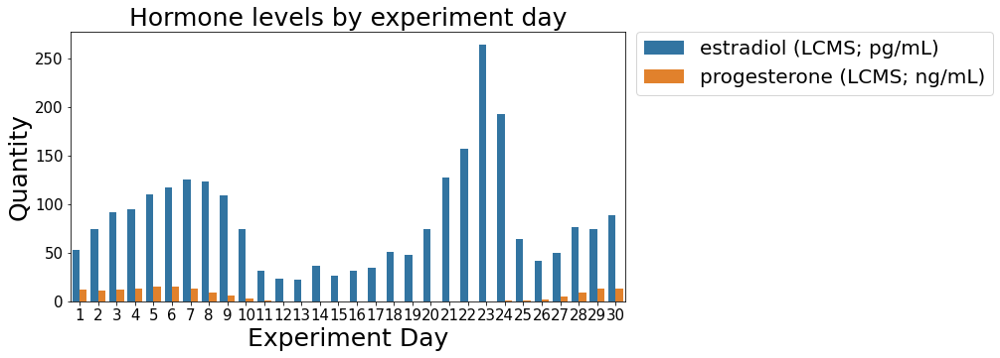

In [27]:
dict_hormones = {'estradiol (LCMS; pg/mL)': hormones_28Me.estradiol, 
                 'progesterone (LCMS; ng/mL)': hormones_28Me.progesterone, 
                 'ExperimentDay': hormones_28Me.ExperimentDay}

df_hormones = pd.DataFrame(dict_hormones)

df_hormones_long = pd.melt(df_hormones, id_vars=['ExperimentDay'], value_vars=['estradiol (LCMS; pg/mL)', 'progesterone (LCMS; ng/mL)'], var_name='hormone', value_name='quantity')


### Plot 

fig, ax = plt.subplots(figsize=(10,5));

ax = sns.barplot(data=df_hormones_long, x="ExperimentDay", y='quantity', hue='hormone')

ax.set_title('Hormone levels by experiment day', fontsize=25);
ax.set_xlabel('Experiment Day', fontsize=25);
ax.set_ylabel('Quantity', fontsize=25);
ax.tick_params(labelsize=15);


ax.legend(fontsize=20, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)


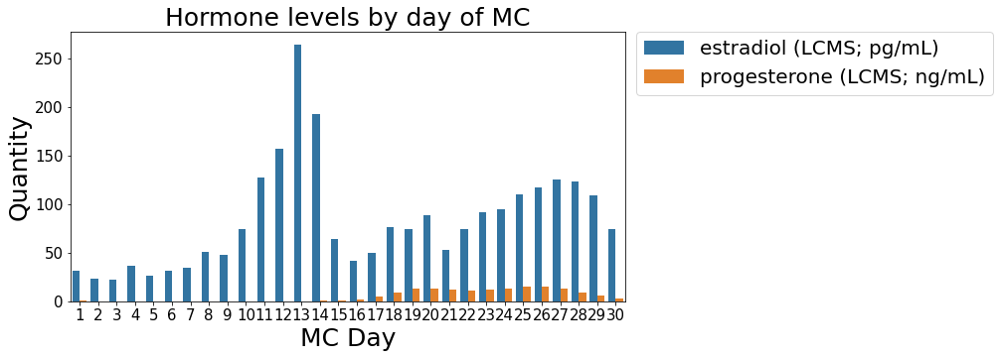

In [28]:
dict_hormones = {'estradiol (LCMS; pg/mL)': hormones_28Me_MCreindexed.estradiol, 
                 'progesterone (LCMS; ng/mL)': hormones_28Me_MCreindexed.progesterone, 
                 'MC day': hormones_28Me_MCreindexed['MC day']}

df_hormones = pd.DataFrame(dict_hormones)

df_hormones_long = pd.melt(df_hormones, id_vars=['MC day'], value_vars=['estradiol (LCMS; pg/mL)', 'progesterone (LCMS; ng/mL)'], var_name='hormone', value_name='quantity')


### Plot 

fig, ax = plt.subplots(figsize=(10,5));

ax = sns.barplot(data=df_hormones_long, x="MC day", y='quantity', hue='hormone')

ax.set_title('Hormone levels by day of MC', fontsize=25);
ax.set_xlabel('MC Day', fontsize=25);
ax.set_ylabel('Quantity', fontsize=25);
ax.tick_params(labelsize=15);


ax.legend(fontsize=20, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)


### 28 & OC

In [29]:
hormones_28OC = hormones[hormones['Experiment'] == '28andOC']
hormones_28OC = hormones_28OC.rename(columns={"Estradiol (LCMS; pg/mL)": "estradiol", "Progesterone (LCMS; ng/mL)": "progesterone", "LH (mIU/ml)": "lh", "FSH (mIU/ml)": "fsh"})


# re-indexing order in menstrual cycle order (for some displays) -> from experimental day 14 -> (index 13)
hormones_28OC_MCreindexed = hormones_28OC.reindex(list(range(43,60))+list(range(30,43)))
hormones_28OC_MCreindexed['MC day'] = list(range(1,31))

In [30]:
hormones_28OC.to_csv(resdir+'hormones_28OC.csv', header = True, index = True)

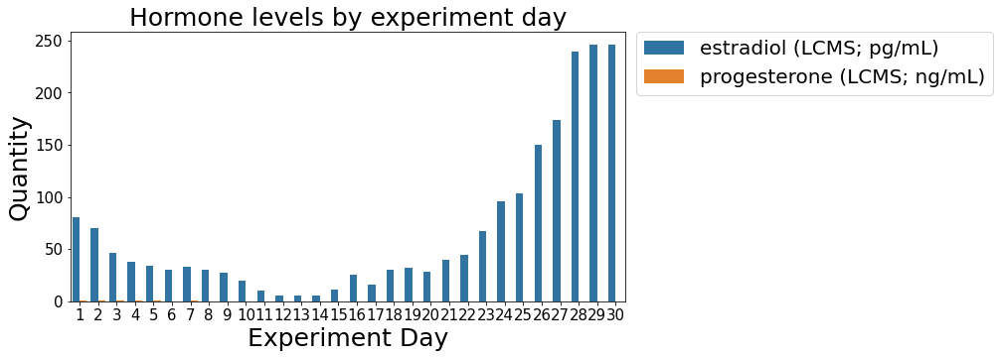

In [31]:
dict_hormones = {'estradiol (LCMS; pg/mL)': hormones_28OC.estradiol, 
                 'progesterone (LCMS; ng/mL)': hormones_28OC.progesterone, 
                 'ExperimentDay': hormones_28OC.ExperimentDay}

df_hormones = pd.DataFrame(dict_hormones)

df_hormones_long = pd.melt(df_hormones, id_vars=['ExperimentDay'], value_vars=['estradiol (LCMS; pg/mL)', 'progesterone (LCMS; ng/mL)'], var_name='hormone', value_name='quantity')


### Plot 

fig, ax = plt.subplots(figsize=(10,5));

ax = sns.barplot(data=df_hormones_long, x="ExperimentDay", y='quantity', hue='hormone')

ax.set_title('Hormone levels by experiment day', fontsize=25);
ax.set_xlabel('Experiment Day', fontsize=25);
ax.set_ylabel('Quantity', fontsize=25);
ax.tick_params(labelsize=15);


ax.legend(fontsize=20, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)


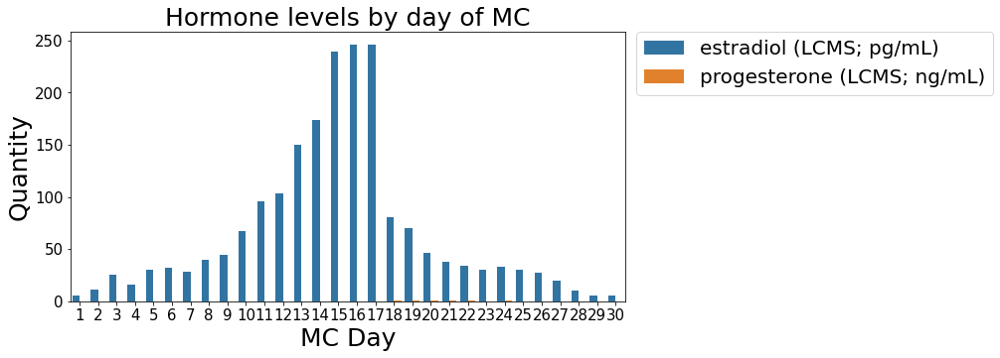

In [32]:
dict_hormones = {'estradiol (LCMS; pg/mL)': hormones_28OC_MCreindexed.estradiol, 
                 'progesterone (LCMS; ng/mL)': hormones_28OC_MCreindexed.progesterone, 
                 'MC day': hormones_28OC_MCreindexed['MC day']}

df_hormones = pd.DataFrame(dict_hormones)

df_hormones_long = pd.melt(df_hormones, id_vars=['MC day'], value_vars=['estradiol (LCMS; pg/mL)', 'progesterone (LCMS; ng/mL)'], var_name='hormone', value_name='quantity')


### Plot 

fig, ax = plt.subplots(figsize=(10,5));

ax = sns.barplot(data=df_hormones_long, x="MC day", y='quantity', hue='hormone')

ax.set_title('Hormone levels by day of MC', fontsize=25);
ax.set_xlabel('MC Day', fontsize=25);
ax.set_ylabel('Quantity', fontsize=25);
ax.tick_params(labelsize=15);


ax.legend(fontsize=20, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)


### 28 & He

In [33]:
hormones_28He = pd.read_csv(datadir+'28andHe_behavior.csv')

hormones_28He_AM = hormones_28He[hormones_28He['time'] == 'Morning']
hormones_28He_PM = hormones_28He[hormones_28He['time'] == 'Evening']

In [34]:
hormones_28He.columns

Index(['session', 'time', 'date (MM/DD/YY)', 'cortisol_serum',
       'cortisol_saliva', 'estradiol_serum', 'free_testosterone_serum',
       'total_testosterone_saliva', 'total_testosterone_serum', 'PSS_raw',
       'PSS_group', 'aggression', 'PSQI_score', 'STAI', 'POMS', 'POMS_tension',
       'POMS_depression', 'POMS_anger', 'POMS_vigor', 'POMS_fatigue',
       'POMS_confusion'],
      dtype='object')

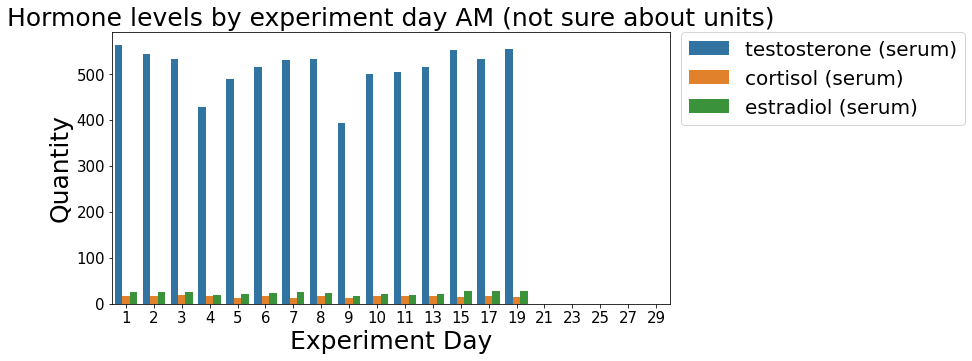

In [35]:
dict_hormones = {'testosterone (serum)': hormones_28He_AM.total_testosterone_serum, 
                 'cortisol (serum)': hormones_28He_AM.cortisol_serum, 
                 'estradiol (serum)': hormones_28He_AM.estradiol_serum, 
                 'ExperimentDay': hormones_28He_AM.session}

df_hormones = pd.DataFrame(dict_hormones)

df_hormones_long = pd.melt(df_hormones, id_vars=['ExperimentDay'], value_vars=['testosterone (serum)', 'cortisol (serum)', 'estradiol (serum)'], var_name='hormone', value_name='quantity')


### Plot 

fig, ax = plt.subplots(figsize=(10,5));

ax = sns.barplot(data=df_hormones_long, x="ExperimentDay", y='quantity', hue='hormone')

ax.set_title('Hormone levels by experiment day AM (not sure about units)', fontsize=25);
ax.set_xlabel('Experiment Day', fontsize=25);
ax.set_ylabel('Quantity', fontsize=25);
ax.tick_params(labelsize=15);


ax.legend(fontsize=20, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)


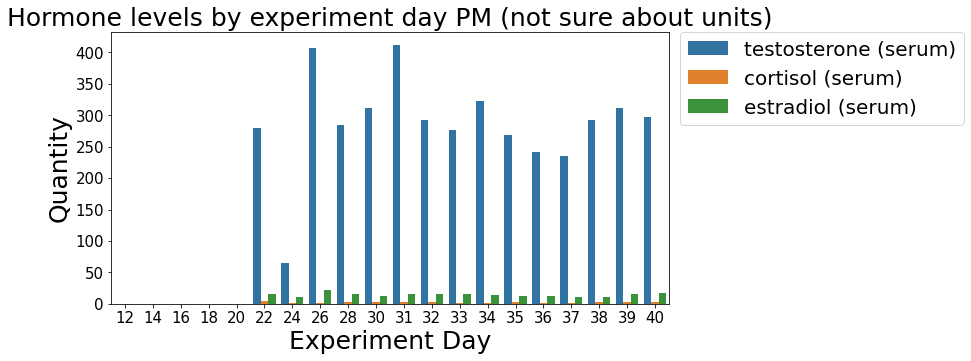

In [36]:
dict_hormones = {'testosterone (serum)': hormones_28He_PM.total_testosterone_serum, 
                 'cortisol (serum)': hormones_28He_PM.cortisol_serum, 
                 'estradiol (serum)': hormones_28He_PM.estradiol_serum, 
                 'ExperimentDay': hormones_28He_PM.session}

df_hormones = pd.DataFrame(dict_hormones)

df_hormones_long = pd.melt(df_hormones, id_vars=['ExperimentDay'], value_vars=['testosterone (serum)', 'cortisol (serum)', 'estradiol (serum)'], var_name='hormone', value_name='quantity')


### Plot 

fig, ax = plt.subplots(figsize=(10,5));

ax = sns.barplot(data=df_hormones_long, x="ExperimentDay", y='quantity', hue='hormone')

ax.set_title('Hormone levels by experiment day PM (not sure about units)', fontsize=25);
ax.set_xlabel('Experiment Day', fontsize=25);
ax.set_ylabel('Quantity', fontsize=25);
ax.tick_params(labelsize=15);


ax.legend(fontsize=20, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)


In [37]:
print(f'Testosterone variability (SD): AM: {round(np.std(hormones_28He_AM.total_testosterone_serum), 2)}, PM: {round(np.std(hormones_28He_PM.total_testosterone_serum), 2)}')
print(f'Cortisol variability (SD): AM: {round(np.std(hormones_28He_AM.cortisol_serum), 2)}, PM: {round(np.std(hormones_28He_PM.cortisol_serum), 2)}')
print(f'Estradiol variability (SD): AM: {round(np.std(hormones_28He_AM.estradiol_serum), 2)}, PM: {round(np.std(hormones_28He_PM.estradiol_serum), 2)}')

Testosterone variability (SD): AM: 45.4, PM: 76.31
Cortisol variability (SD): AM: 2.04, PM: 0.86
Estradiol variability (SD): AM: 3.46, PM: 2.77


In [38]:
np.std(hormones_28He_PM.total_testosterone_serum)

76.31060039950762

#### Associations serum/saliva levels

##### Testosterone

(array([1., 0., 0., 0., 0., 0., 1., 1., 4., 5., 1., 0., 0., 3., 1., 0., 0.,
        3., 6., 4.]),
 array([ 64.4 ,  89.38, 114.36, 139.34, 164.32, 189.3 , 214.28, 239.26,
        264.24, 289.22, 314.2 , 339.18, 364.16, 389.14, 414.12, 439.1 ,
        464.08, 489.06, 514.04, 539.02, 564.  ]),
 <BarContainer object of 20 artists>)

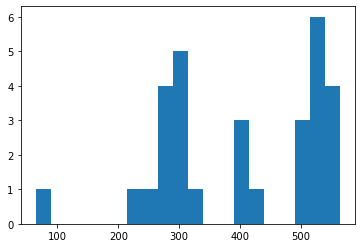

In [39]:
plt.hist(hormones_28He['total_testosterone_serum'], bins=20)

In [40]:
stats.spearmanr(hormones_28He['total_testosterone_serum'], hormones_28He['total_testosterone_saliva'], nan_policy='omit')

SpearmanrResult(correlation=0.8955690044151291, pvalue=2.3487895284053423e-11)

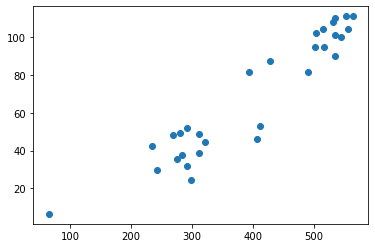

In [41]:
plt.scatter(hormones_28He['total_testosterone_serum'], hormones_28He['total_testosterone_saliva'])

##### Cortisol

(array([9., 4., 1., 1., 0., 0., 0., 0., 0., 0., 0., 2., 1., 0., 2., 1., 8.,
        0., 0., 1.]),
 array([ 1.6  ,  2.521,  3.442,  4.363,  5.284,  6.205,  7.126,  8.047,
         8.968,  9.889, 10.81 , 11.731, 12.652, 13.573, 14.494, 15.415,
        16.336, 17.257, 18.178, 19.099, 20.02 ]),
 <BarContainer object of 20 artists>)

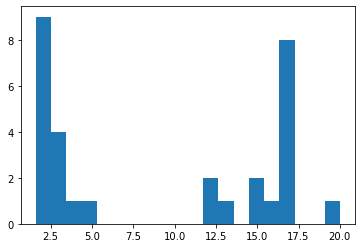

In [42]:
plt.hist(hormones_28He['cortisol_serum'], bins=20)

In [43]:
stats.spearmanr(hormones_28He['cortisol_serum'], hormones_28He['cortisol_saliva'], nan_policy='omit')

SpearmanrResult(correlation=0.915044727717242, pvalue=1.4772012682045496e-12)

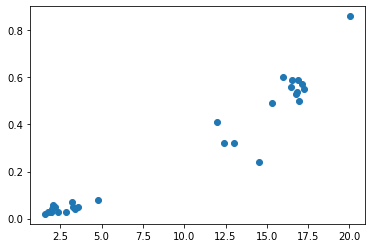

In [44]:
plt.scatter(hormones_28He['cortisol_serum'], hormones_28He['cortisol_saliva'])

# Building gradients (Me)

## Mean gradient

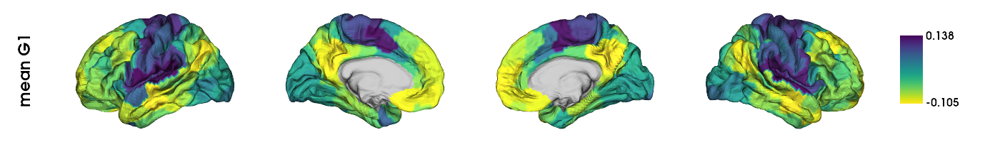

In [34]:
### Build mean gradient

# compute the mean connectivity matrix (by averaging the connectivity matrices of all subjects)
mean_fc_matrix = sum(fc_matrices)/len(fc_matrices)


## compute the mean gradients 

# GradientMaps function used to build the model parameters
mean_fc_grad = GradientMaps(n_components = 10, random_state = 0, approach = 'dm', kernel = 'normalized_angle')

# fit function used to compute the gradients
mean_fc_grad.fit(mean_fc_matrix)

# mean G1
mean_fc_G1 = mean_fc_grad.gradients_[:,0]



### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network 
#And the only options for plotting in brainspace are either Schaefer 400 (7 networks) or fsaverage5

mean_fc_G1_fs5 = schaefer400_to_fs5(schaefer400_data = mean_fc_G1, seven_networks=False)



### Plot on hemispheres

# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = mean_fc_G1_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'viridis_r', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["mean G1"],
    zoom = 1.45)

plotted_hemispheres

## Aligned gradients

In [35]:
compute_aligned_grad = compute_aligned_gradients(fc_matrices, mean_fc_grad.gradients_)

# storing the output of the computation of the aligned gradients
#array_aligned_gradients = compute_aligned_grad['array_aligned_gradients']
array_aligned_fc_G1 = compute_aligned_grad['array_aligned_G1']

### Export gradient to csv for dispersion analyses

In [36]:
# fmt = decimals

np.savetxt(resdir+'array_aligned_fc_G1.csv', array_aligned_fc_G1, delimiter=',', fmt = '%.16g', header = '', comments = '')

## Variability in gradients

### Visualize daily gradients

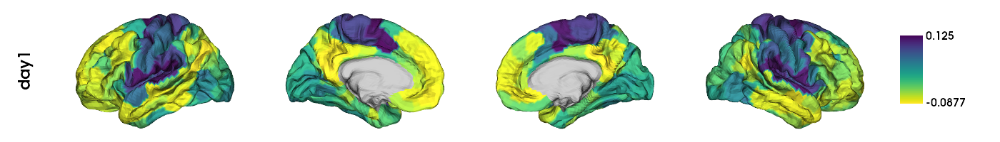

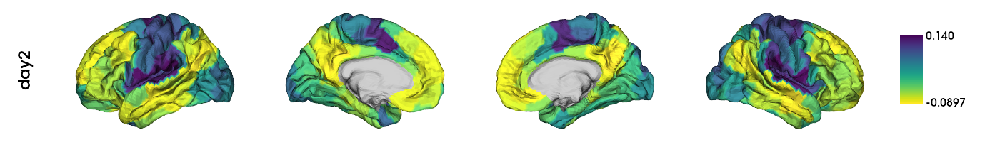

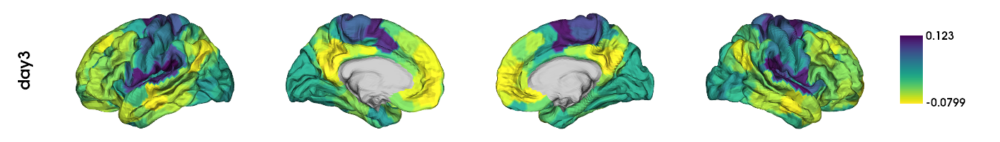

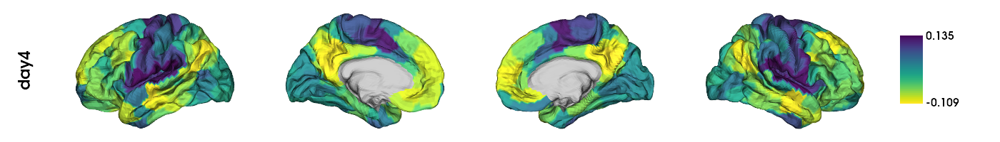

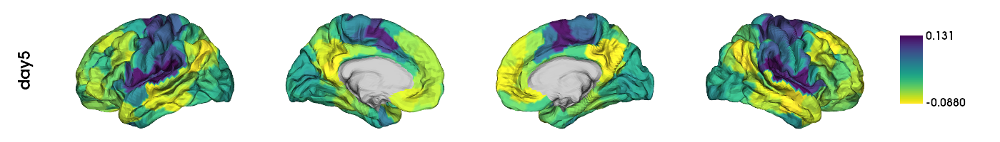

...

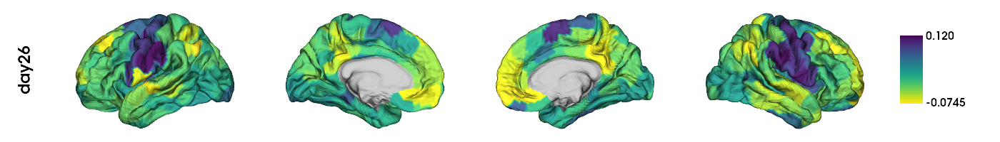

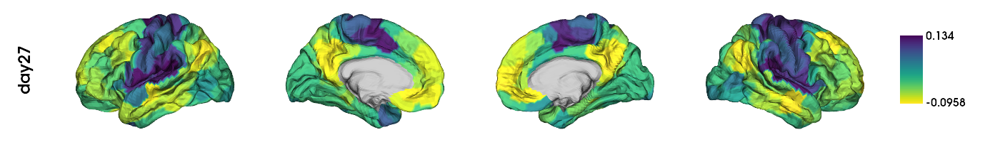

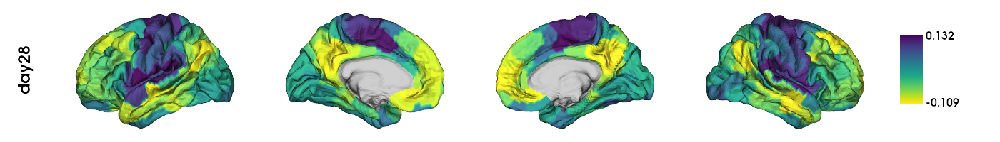

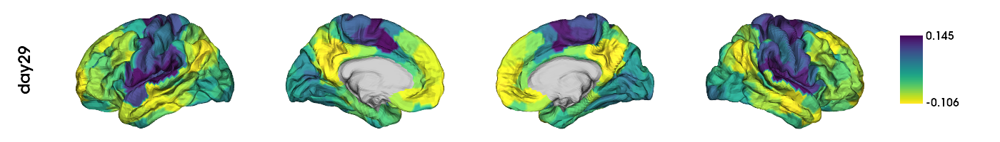

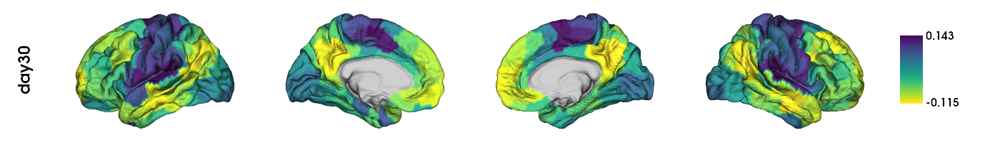

In [37]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


# define handles list to hold the 30 days data to plot on hemispheres
handles = []
    
    
# iterate over  MC cycle days
for i in range(len(array_aligned_fc_G1)):
    
    # transform to fs5 for plotting
    fc_G1_fs5 = schaefer400_to_fs5(schaefer400_data = array_aligned_fc_G1[i], seven_networks=False)
    
    # plot on hemispheres
    plotted_hemispheres_byday = plot_hemispheres(
        surf_lh, 
        surf_rh, 
        array_name = fc_G1_fs5, 
        embed_nb = True, 
        size = (1400,200), 
        cmap = 'viridis_r', 
        color_bar = True, 
        #color_range = color_range_t,
        nan_color = (0.7, 0.7, 0.7, 1),
        label_text = ["day"+str(i+1)],
        zoom = 1.45)

    # append current day to handles
    handles.append(plotted_hemispheres_byday)
    
# display handles
display(*handles)

### Quantify variability

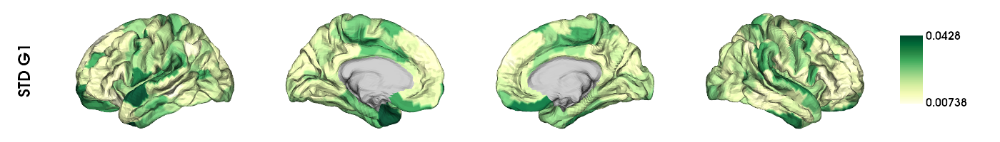

In [38]:
# compute the standard deviation across days per parcel
std_fc_G1 = np.std(array_aligned_fc_G1, axis=0)


## Plot

# convert to fs5 for plotting
std_fc_G1_fs5 = schaefer400_to_fs5(schaefer400_data = std_fc_G1, seven_networks=False)

# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


# plot hemispheres
plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = std_fc_G1_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'YlGn', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["STD G1"],
    zoom = 1.45)

plotted_hemispheres

2023-08-11 14:41:48,810 - matplotlib.legend - WARNING - No handles with labels found to put in legend.


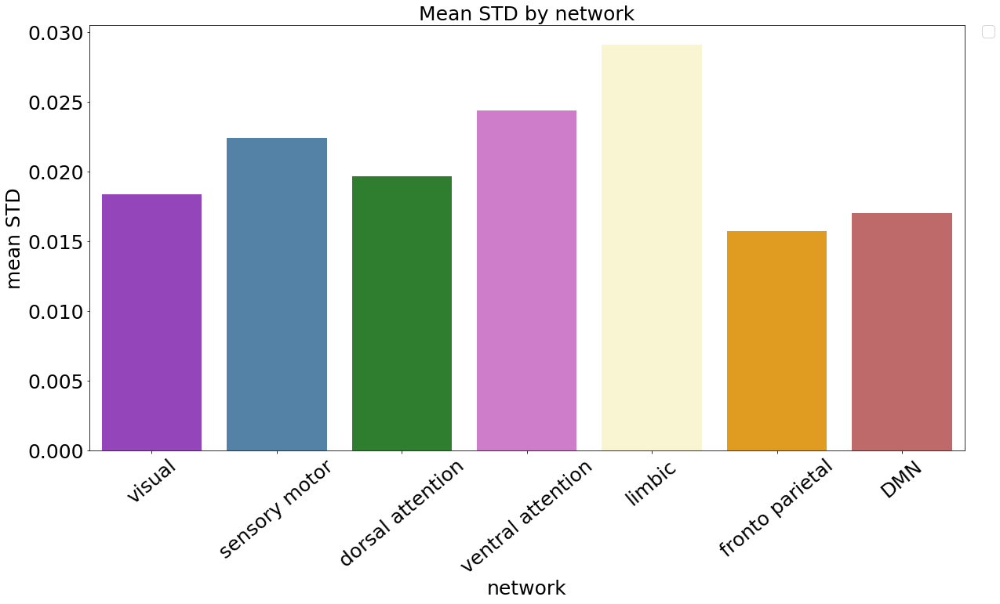

In [39]:
### Shape data in a plottable format

# lists that will contain std per sex per network
visual_std_grad = []
sensorimotor_std_grad = []
dorsalattention_std_grad = []
ventralattention_std_grad = []
limbic_std_grad = []
frontoparietal_std_grad = []
dmn_std_grad = []


# iterating over 400 parcels (of std) 
for i in range(len(std_fc_G1)):

    # append given parcel's std gradient loading to the corresponding list depending on what network it belongs to (and by sex)
    if yeo_17_2_7_networks_array_labels[i] == 'visual':
        visual_std_grad.append(std_fc_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'sensory motor':
        sensorimotor_std_grad.append(std_fc_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'dorsal attention':
        dorsalattention_std_grad.append(std_fc_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'ventral attention':
        ventralattention_std_grad.append(std_fc_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'limbic':
        limbic_std_grad.append(std_fc_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'fronto parietal':
        frontoparietal_std_grad.append(std_fc_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'DMN':
        dmn_std_grad.append(std_fc_G1[i])
        
        

# shape specifically for sns plotting

dict_std_fc_G1 = {'visual': statistics.mean(visual_std_grad), 
                  'sensory motor': statistics.mean(sensorimotor_std_grad), 
                  'dorsal attention': statistics.mean(dorsalattention_std_grad), 
                  'ventral attention': statistics.mean(ventralattention_std_grad), 
                  'limbic': statistics.mean(limbic_std_grad),
                  'fronto parietal': statistics.mean(frontoparietal_std_grad), 
                  'DMN': statistics.mean(dmn_std_grad), 
                  'id': [1]*30}

df_std_fc_G1 = pd.DataFrame(dict_std_fc_G1)

df_std_fc_G1_long = pd.melt(df_std_fc_G1, id_vars=['id'], value_vars=['visual', 'sensory motor', 'dorsal attention', 'ventral attention', 'limbic', 'fronto parietal', 'DMN'], var_name='network', value_name='mean sd')



### Plot 

fig, ax = plt.subplots(figsize=(20,10));

ax = sns.barplot(data=df_std_fc_G1_long, x='network', y='mean sd', palette=palette_labeled_networks)


ax.set_title('Mean STD by network', fontsize=25);
ax.set_xlabel('network', fontsize=25);
ax.set_ylabel('mean STD', fontsize=25);
ax.tick_params(labelsize=25);

ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="center")
ax.legend(fontsize=20, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)


# Building gradients (Me; exclusion day 26)

## Visualize gradient on day 26 to observe that there is indeed a problem

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:292: UserWarning: Support for interactive mode is only provided for a single renderer: 'nrow=1' and 'ncol=1'. Setting 'interactive=False'
  warnings.warn("Support for interactive mode is only provided for "


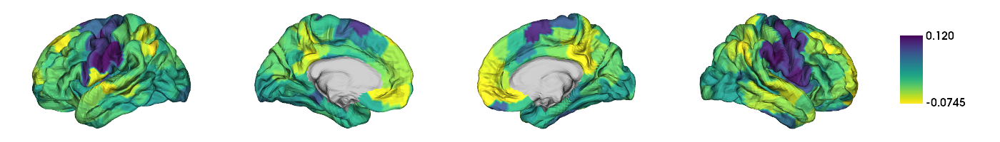

In [40]:
#### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network (used in brainspace plot hemispheres)

aligned_fc_G1_D26_fs5 = schaefer400_to_fs5(schaefer400_data = array_aligned_fc_G1[25], seven_networks=False)

#### Plot on hemispheres

# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])

plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = aligned_fc_G1_D26_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'viridis_r', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    #label_text = [""],
    zoom = 1.45)


## Exclude day 26

In [90]:
fc_matrices_excl26 = np.delete(fc_matrices, 25, axis = 0)

hormones_28Me_excl26 = hormones_28Me.drop(25)

Export to csv

In [91]:
hormones_28Me_excl26.to_csv(resdir+'hormones_28Me_excl26.csv', header = True, index = True)

In [92]:
# re-indexing order in menstrual cycle order -> from experimental day 11 -> (index 10)
hormones_28Me_excl26_MCreindexed = hormones_28Me_excl26.reindex(list(range(10,30))+list(range(0,10)))
hormones_28Me_excl26_MCreindexed['MC day'] = list(range(1,31))

hormones_28Me_excl26_MCreindexed = hormones_28Me_excl26_MCreindexed.drop(25)  # remove the row of day 26 with nans

## Mean gradient

In [93]:
# compute the mean connectivity matrix (by averaging the connectivity matrices of all subjects)
mean_fc_matrix_excl26 = sum(fc_matrices_excl26)/len(fc_matrices_excl26)


## compute the mean gradients 

# GradientMaps function used to build the model parameters
mean_fc_grad_excl26 = GradientMaps(n_components = 10, random_state = 0, approach = 'dm', kernel = 'normalized_angle')

# fit function used to compute the gradients
mean_fc_grad_excl26.fit(mean_fc_matrix_excl26)

# mean G1
mean_fc_G1_excl26 = mean_fc_grad_excl26.gradients_[:,0]

### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network 
And the only options for plotting in brainspace are either Schaefer 400 (7 networks) or fsaverage5

In [94]:
mean_fc_G1_excl26_fs5 = schaefer400_to_fs5(schaefer400_data = mean_fc_G1_excl26, seven_networks=False)

### Plot on hemispheres

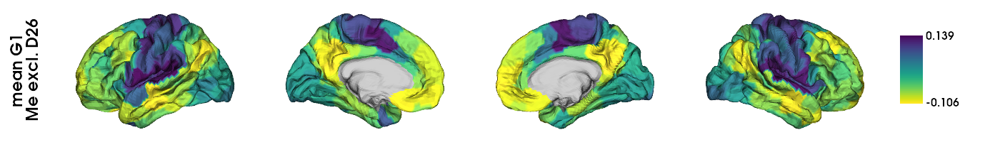

In [95]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = mean_fc_G1_excl26_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'viridis_r', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["mean G1\nMe excl. D26"],
    zoom = 1.45)

plotted_hemispheres

## Aligned gradients

In [46]:
compute_aligned_grad_excl26 = compute_aligned_gradients(fc_matrices_excl26, mean_fc_grad_excl26.gradients_)

# storing the output of the computation of the aligned gradients
#array_aligned_gradients = compute_aligned_grad['array_aligned_gradients']
array_aligned_fc_G1_excl26 = compute_aligned_grad_excl26['array_aligned_G1']

### Export gradient to csv for dispersion analyses

In [47]:
# fmt = decimals

np.savetxt(resdir+'array_aligned_fc_G1_excl26.csv', array_aligned_fc_G1_excl26, delimiter=',', fmt = '%.16g', header = '', comments = '')

### Reindex from experimental day 11 -> (index 10) in order to put in MC day format

In [72]:
array_aligned_fc_G1_excl26_MCreindexed = np.concatenate((array_aligned_fc_G1_excl26[10:], array_aligned_fc_G1_excl26[:10]))

## Variability in gradients

### Quantify variability

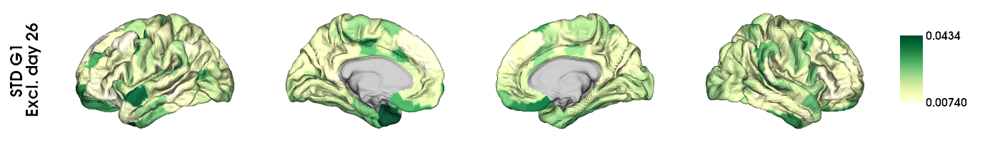

In [51]:
# compute the standard deviation across days per parcel
std_fc_G1_excl26 = np.std(array_aligned_fc_G1_excl26, axis=0)


## Plot

# convert to fs5 for plotting
std_fc_G1_excl26_fs5 = schaefer400_to_fs5(schaefer400_data = std_fc_G1_excl26, seven_networks=False)

# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


# plot hemispheres
plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = std_fc_G1_excl26_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'YlGn', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["STD G1\nExcl. day 26"],
    zoom = 1.45)

plotted_hemispheres

2023-08-10 13:44:45,770 - matplotlib.legend - WARNING - No handles with labels found to put in legend.


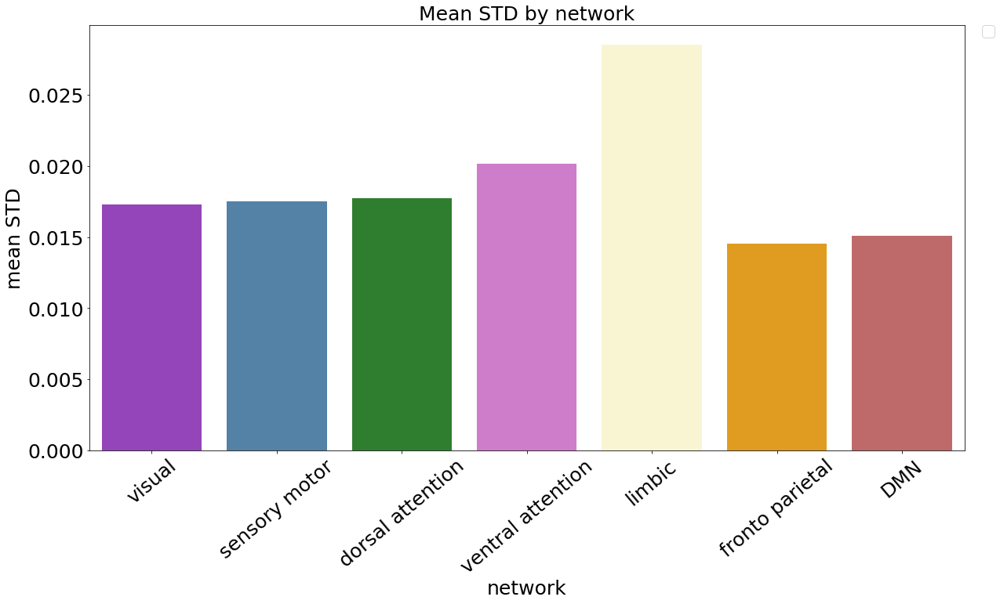

In [52]:
### Shape data in a plottable format

# lists that will contain std per sex per network
visual_std_grad = []
sensorimotor_std_grad = []
dorsalattention_std_grad = []
ventralattention_std_grad = []
limbic_std_grad = []
frontoparietal_std_grad = []
dmn_std_grad = []


# iterating over 400 parcels (of std) 
for i in range(len(std_fc_G1_excl26)):

    # append given parcel's std gradient loading to the corresponding list depending on what network it belongs to (and by sex)
    if yeo_17_2_7_networks_array_labels[i] == 'visual':
        visual_std_grad.append(std_fc_G1_excl26[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'sensory motor':
        sensorimotor_std_grad.append(std_fc_G1_excl26[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'dorsal attention':
        dorsalattention_std_grad.append(std_fc_G1_excl26[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'ventral attention':
        ventralattention_std_grad.append(std_fc_G1_excl26[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'limbic':
        limbic_std_grad.append(std_fc_G1_excl26[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'fronto parietal':
        frontoparietal_std_grad.append(std_fc_G1_excl26[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'DMN':
        dmn_std_grad.append(std_fc_G1_excl26[i])
        
        

# shape specifically for sns plotting

dict_std_fc_G1_excl26 = {'visual': statistics.mean(visual_std_grad), 
                  'sensory motor': statistics.mean(sensorimotor_std_grad), 
                  'dorsal attention': statistics.mean(dorsalattention_std_grad), 
                  'ventral attention': statistics.mean(ventralattention_std_grad), 
                  'limbic': statistics.mean(limbic_std_grad),
                  'fronto parietal': statistics.mean(frontoparietal_std_grad), 
                  'DMN': statistics.mean(dmn_std_grad), 
                  'id': [1]*30}

df_std_fc_G1_excl26 = pd.DataFrame(dict_std_fc_G1_excl26)

df_std_fc_G1_excl26_long = pd.melt(df_std_fc_G1_excl26, id_vars=['id'], value_vars=['visual', 'sensory motor', 'dorsal attention', 'ventral attention', 'limbic', 'fronto parietal', 'DMN'], var_name='network', value_name='mean sd')



### Plot 

fig, ax = plt.subplots(figsize=(20,10));

ax = sns.barplot(data=df_std_fc_G1_excl26_long, x='network', y='mean sd', palette=palette_labeled_networks)


ax.set_title('Mean STD by network', fontsize=25);
ax.set_xlabel('network', fontsize=25);
ax.set_ylabel('mean STD', fontsize=25);
ax.tick_params(labelsize=25);

ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="center")
ax.legend(fontsize=20, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)


# Building gradients (OC)

## Mean gradient

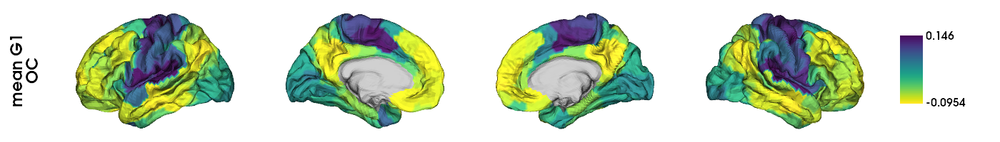

In [118]:
### Build mean gradient

# compute the mean connectivity matrix (by averaging the connectivity matrices of all subjects)
mean_fc_matrix_OC = sum(fc_matrices_OC)/len(fc_matrices_OC)


## compute the mean gradients 

# GradientMaps function used to build the model parameters
mean_fc_grad_OC = GradientMaps(n_components = 10, random_state = 0, approach = 'dm', kernel = 'normalized_angle')

# fit function used to compute the gradients
mean_fc_grad_OC.fit(mean_fc_matrix_OC)

# mean G1
mean_fc_G1_OC = mean_fc_grad_OC.gradients_[:,0]



### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network 
#And the only options for plotting in brainspace are either Schaefer 400 (7 networks) or fsaverage5

mean_fc_G1_OC_fs5 = schaefer400_to_fs5(schaefer400_data = mean_fc_G1_OC, seven_networks=False)



### Plot on hemispheres

# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = mean_fc_G1_OC_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'viridis_r', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["mean G1\nOC"],
    zoom = 1.45)

plotted_hemispheres

## Aligned gradients

In [119]:
compute_aligned_grad_OC = compute_aligned_gradients(fc_matrices_OC, mean_fc_grad_OC.gradients_)

# storing the output of the computation of the aligned gradients
#array_aligned_gradients = compute_aligned_grad['array_aligned_gradients']
array_aligned_fc_OC_G1 = compute_aligned_grad_OC['array_aligned_G1']

### Export gradient to csv for dispersion analyses

In [120]:
# fmt = decimals

np.savetxt(resdir+'array_aligned_fc_OC_G1.csv', array_aligned_fc_OC_G1, delimiter=',', fmt = '%.16g', header = '', comments = '')

### Reindex from experimental day 14 -> (index 13) in order to put in MC day format

In [121]:
array_aligned_fc_OC_G1_MCreindexed = np.concatenate((array_aligned_fc_OC_G1[13:], array_aligned_fc_OC_G1[:13]))

## Variability in gradients

### Visualize daily gradients

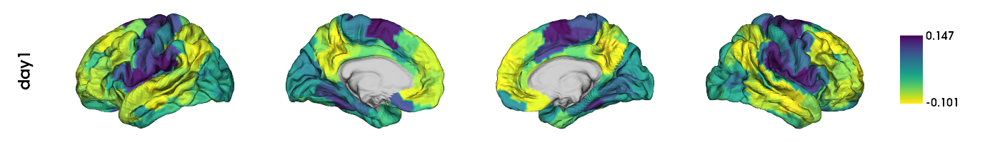

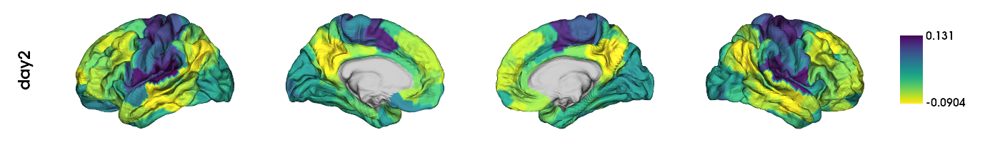

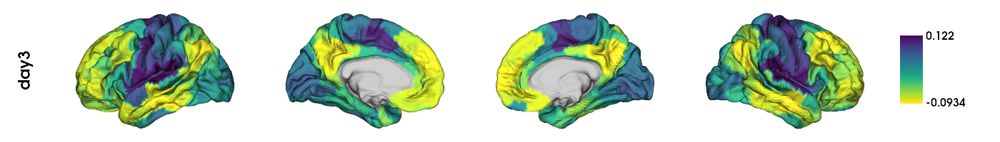

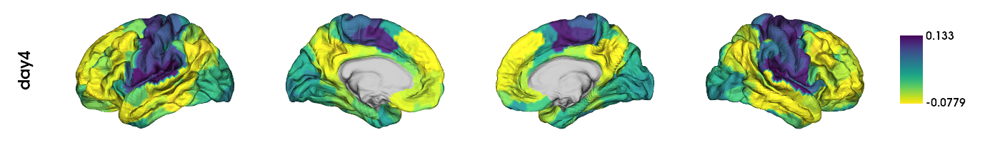

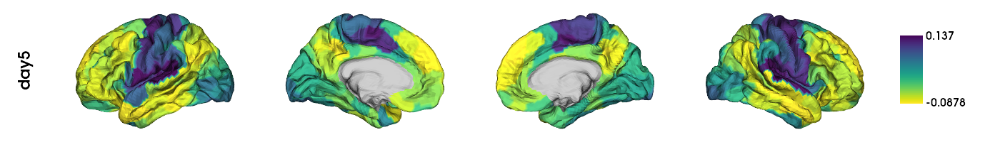

...

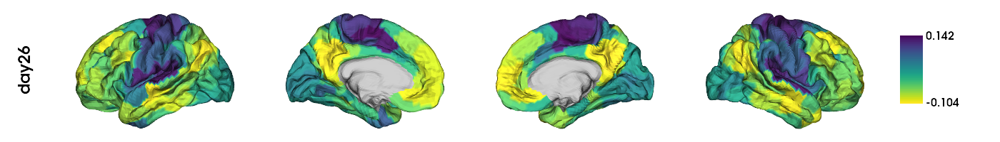

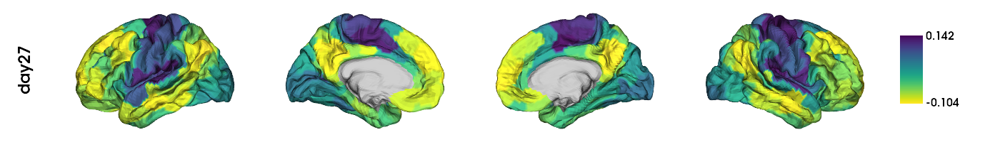

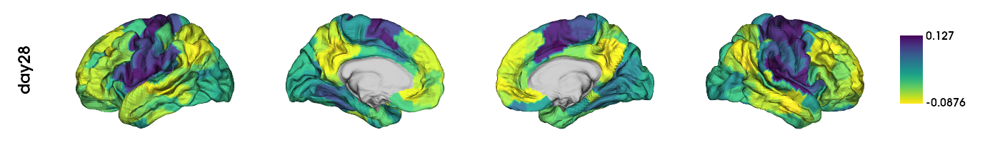

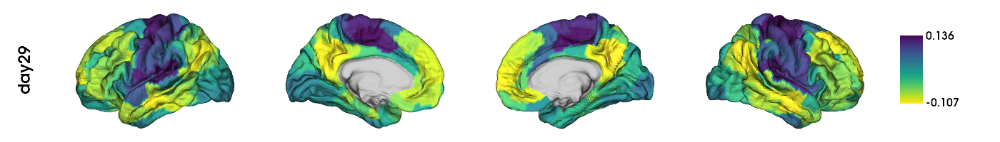

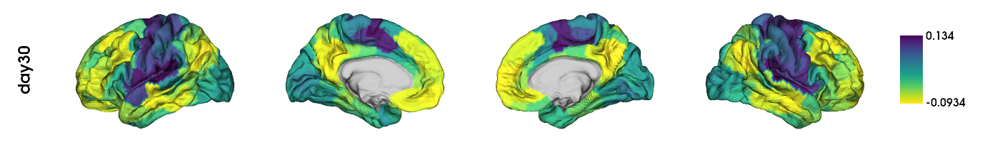

In [184]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


# define handles list to hold the 30 days data to plot on hemispheres
handles = []
    
    
# iterate over  MC cycle days
for i in range(len(array_aligned_fc_OC_G1)):
    
    # transform to fs5 for plotting
    fc_G1_OC_fs5 = schaefer400_to_fs5(schaefer400_data = array_aligned_fc_OC_G1[i], seven_networks=False)
    
    # plot on hemispheres
    plotted_hemispheres_byday = plot_hemispheres(
        surf_lh, 
        surf_rh, 
        array_name = fc_G1_OC_fs5, 
        embed_nb = True, 
        size = (1400,200), 
        cmap = 'viridis_r', 
        color_bar = True, 
        #color_range = color_range_t,
        nan_color = (0.7, 0.7, 0.7, 1),
        label_text = ["day"+str(i+1)],
        zoom = 1.45)

    # append current day to handles
    handles.append(plotted_hemispheres_byday)
    
# display handles
display(*handles)

### Quantify variability

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:292: UserWarning: Support for interactive mode is only provided for a single renderer: 'nrow=1' and 'ncol=1'. Setting 'interactive=False'
  warnings.warn("Support for interactive mode is only provided for "


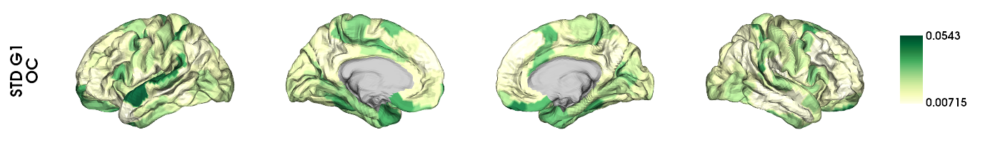

In [187]:
# compute the standard deviation across days per parcel
std_fc_OC_G1 = np.std(array_aligned_fc_OC_G1, axis=0)


## Plot

# convert to fs5 for plotting
std_fc_OC_G1_fs5 = schaefer400_to_fs5(schaefer400_data = std_fc_OC_G1, seven_networks=False)

# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


# plot hemispheres
plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = std_fc_OC_G1_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'YlGn', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["STD G1\nOC"],
    zoom = 1.45)

plotted_hemispheres

2023-08-10 17:27:56,705 - matplotlib.legend - WARNING - No handles with labels found to put in legend.


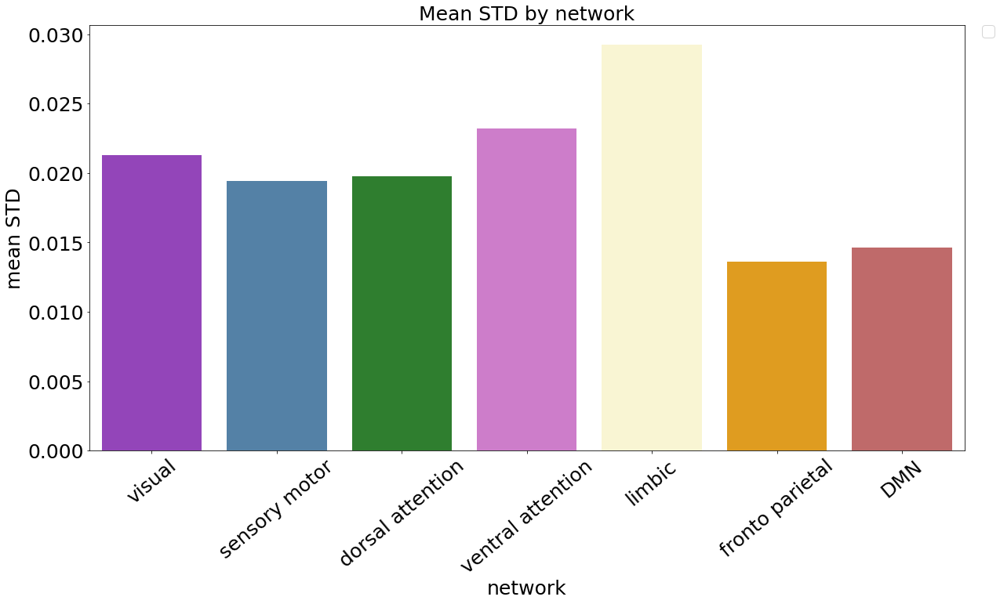

In [186]:
### Shape data in a plottable format

# lists that will contain std per sex per network
visual_std_grad = []
sensorimotor_std_grad = []
dorsalattention_std_grad = []
ventralattention_std_grad = []
limbic_std_grad = []
frontoparietal_std_grad = []
dmn_std_grad = []


# iterating over 400 parcels (of std) 
for i in range(len(std_fc_OC_G1)):

    # append given parcel's std gradient loading to the corresponding list depending on what network it belongs to (and by sex)
    if yeo_17_2_7_networks_array_labels[i] == 'visual':
        visual_std_grad.append(std_fc_OC_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'sensory motor':
        sensorimotor_std_grad.append(std_fc_OC_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'dorsal attention':
        dorsalattention_std_grad.append(std_fc_OC_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'ventral attention':
        ventralattention_std_grad.append(std_fc_OC_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'limbic':
        limbic_std_grad.append(std_fc_OC_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'fronto parietal':
        frontoparietal_std_grad.append(std_fc_OC_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'DMN':
        dmn_std_grad.append(std_fc_OC_G1[i])
        
        

# shape specifically for sns plotting

dict_std_fc_OC_G1 = {'visual': statistics.mean(visual_std_grad), 
                  'sensory motor': statistics.mean(sensorimotor_std_grad), 
                  'dorsal attention': statistics.mean(dorsalattention_std_grad), 
                  'ventral attention': statistics.mean(ventralattention_std_grad), 
                  'limbic': statistics.mean(limbic_std_grad),
                  'fronto parietal': statistics.mean(frontoparietal_std_grad), 
                  'DMN': statistics.mean(dmn_std_grad), 
                  'id': [1]*30}

df_std_fc_OC_G1 = pd.DataFrame(dict_std_fc_OC_G1)

df_std_fc_OC_G1_long = pd.melt(df_std_fc_OC_G1, id_vars=['id'], value_vars=['visual', 'sensory motor', 'dorsal attention', 'ventral attention', 'limbic', 'fronto parietal', 'DMN'], var_name='network', value_name='mean sd')



### Plot 

fig, ax = plt.subplots(figsize=(20,10));

ax = sns.barplot(data=df_std_fc_OC_G1_long, x='network', y='mean sd', palette=palette_labeled_networks)


ax.set_title('Mean STD by network', fontsize=25);
ax.set_xlabel('network', fontsize=25);
ax.set_ylabel('mean STD', fontsize=25);
ax.tick_params(labelsize=25);

ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="center")
ax.legend(fontsize=20, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)


# Building gradients (He; AM)

## Mean gradient

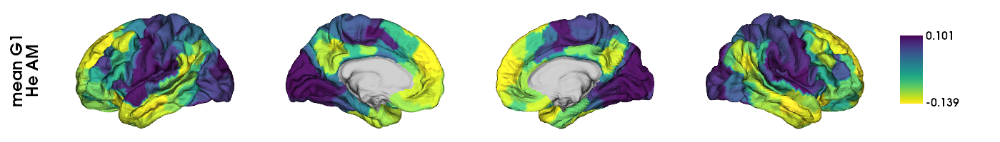

In [99]:
### Build mean gradient

# compute the mean connectivity matrix (by averaging the connectivity matrices of all subjects)
mean_fc_matrix_He_AM = sum(fc_matrices_He_AM)/len(fc_matrices_He_AM)


## compute the mean gradients 

# GradientMaps function used to build the model parameters
mean_fc_grad_He_AM = GradientMaps(n_components = 10, random_state = 0, approach = 'dm', kernel = 'normalized_angle')

# fit function used to compute the gradients
mean_fc_grad_He_AM.fit(mean_fc_matrix_He_AM)

# mean G1 -> flip mean G1 for it to be in the same direction as female G1
mean_fc_G1_He_AM = mean_fc_grad_He_AM.gradients_[:,0]*-1



### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network 
#And the only options for plotting in brainspace are either Schaefer 400 (7 networks) or fsaverage5

mean_fc_G1_He_AM_fs5 = schaefer400_to_fs5(schaefer400_data = mean_fc_G1_He_AM, seven_networks=False)



### Plot on hemispheres

# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = mean_fc_G1_He_AM_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'viridis_r', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["mean G1\nHe AM"],
    zoom = 1.45)

plotted_hemispheres

## Aligned gradients

In [103]:
compute_aligned_grad_He_AM = compute_aligned_gradients(fc_matrices_He_AM, mean_fc_grad_He_AM.gradients_*-1)  # *-1 to flip all the 10 mean gradients

# storing the output of the computation of the aligned gradients
#array_aligned_gradients = compute_aligned_grad['array_aligned_gradients']
array_aligned_fc_He_AM_G1 = compute_aligned_grad_He_AM['array_aligned_G1']

### Export gradient to csv for dispersion analyses

In [101]:
# fmt = decimals

np.savetxt(resdir+'array_aligned_fc_He_AM_G1.csv', array_aligned_fc_He_AM_G1, delimiter=',', fmt = '%.16g', header = '', comments = '')

## Variability in gradients

### Visualize daily gradients

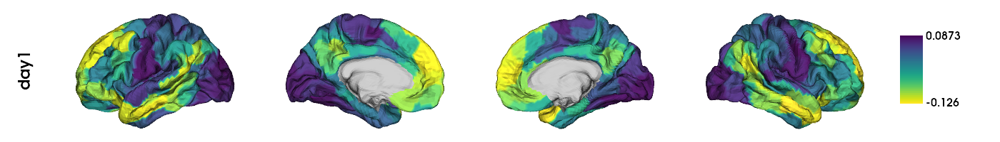

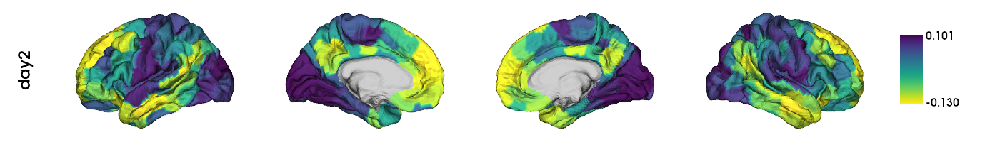

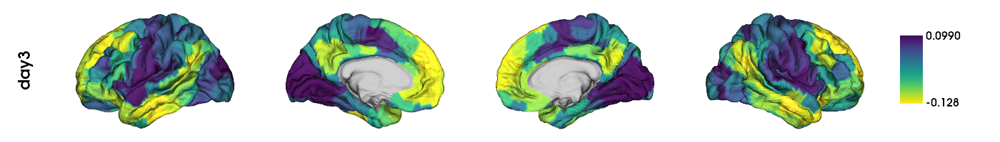

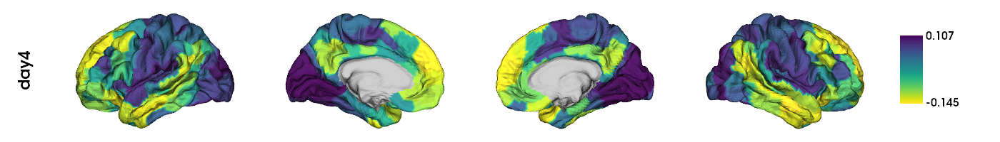

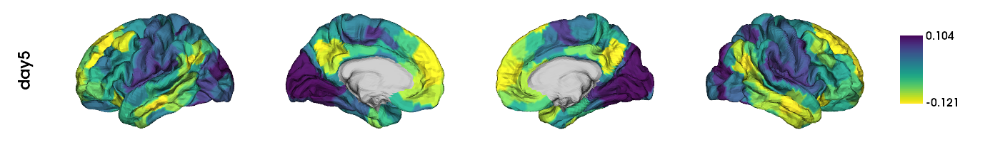

...

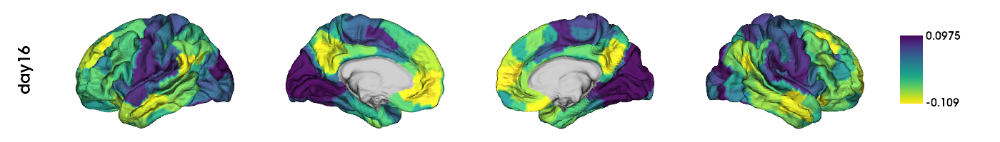

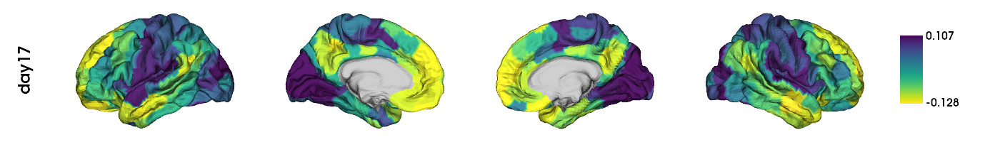

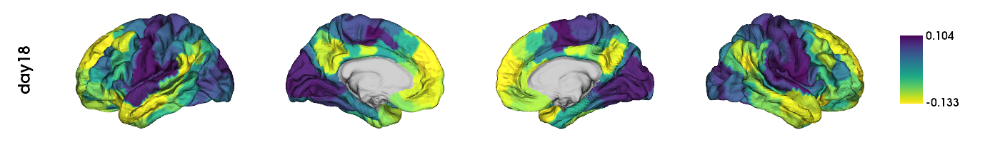

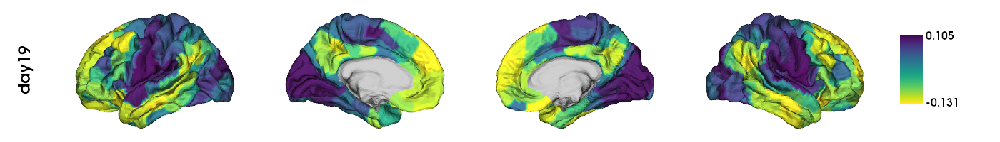

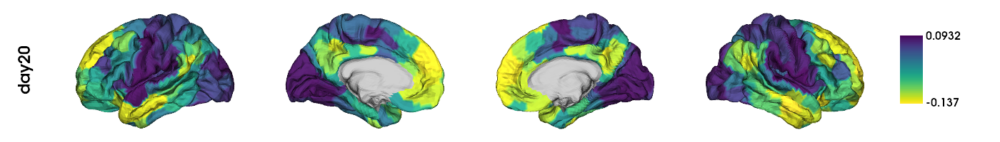

In [102]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


# define handles list to hold the 30 days data to plot on hemispheres
handles = []
    
    
# iterate over  MC cycle days
for i in range(len(array_aligned_fc_He_AM_G1)):
    
    # transform to fs5 for plotting
    fc_He_AM_G1_fs5 = schaefer400_to_fs5(schaefer400_data = array_aligned_fc_He_AM_G1[i], seven_networks=False)
    
    # plot on hemispheres
    plotted_hemispheres_byday = plot_hemispheres(
        surf_lh, 
        surf_rh, 
        array_name = fc_He_AM_G1_fs5, 
        embed_nb = True, 
        size = (1400,200), 
        cmap = 'viridis_r', 
        color_bar = True, 
        #color_range = color_range_t,
        nan_color = (0.7, 0.7, 0.7, 1),
        label_text = ["day"+str(i+1)],
        zoom = 1.45)

    # append current day to handles
    handles.append(plotted_hemispheres_byday)
    
# display handles
display(*handles)

### Quantify variability

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:292: UserWarning: Support for interactive mode is only provided for a single renderer: 'nrow=1' and 'ncol=1'. Setting 'interactive=False'
  warnings.warn("Support for interactive mode is only provided for "


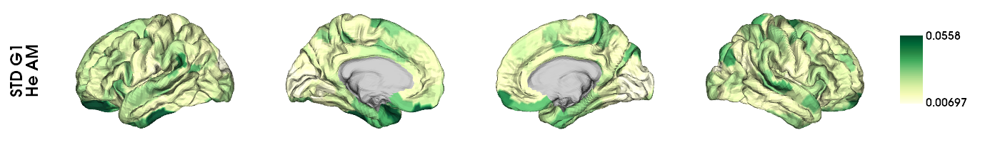

In [116]:
# compute the standard deviation across days per parcel
std_fc_He_AM_G1 = np.std(array_aligned_fc_He_AM_G1, axis=0)


## Plot

# convert to fs5 for plotting
std_fc_He_AM_G1_fs5 = schaefer400_to_fs5(schaefer400_data = std_fc_He_AM_G1, seven_networks=False)

# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


# plot hemispheres
plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = std_fc_He_AM_G1_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'YlGn', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["STD G1\nHe AM"],
    zoom = 1.45)

plotted_hemispheres

2023-09-22 16:47:24,099 - matplotlib.legend - WARNING - No handles with labels found to put in legend.


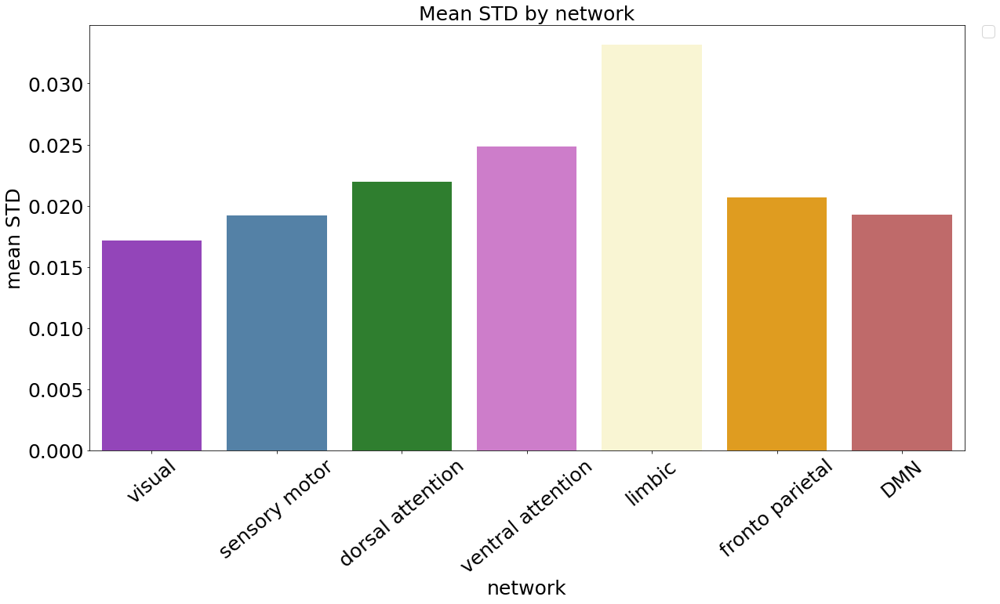

In [107]:
### Shape data in a plottable format

# lists that will contain std per sex per network
visual_std_grad = []
sensorimotor_std_grad = []
dorsalattention_std_grad = []
ventralattention_std_grad = []
limbic_std_grad = []
frontoparietal_std_grad = []
dmn_std_grad = []


# iterating over 400 parcels (of std) 
for i in range(len(std_fc_G1)):

    # append given parcel's std gradient loading to the corresponding list depending on what network it belongs to (and by sex)
    if yeo_17_2_7_networks_array_labels[i] == 'visual':
        visual_std_grad.append(std_fc_He_AM_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'sensory motor':
        sensorimotor_std_grad.append(std_fc_He_AM_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'dorsal attention':
        dorsalattention_std_grad.append(std_fc_He_AM_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'ventral attention':
        ventralattention_std_grad.append(std_fc_He_AM_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'limbic':
        limbic_std_grad.append(std_fc_He_AM_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'fronto parietal':
        frontoparietal_std_grad.append(std_fc_He_AM_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'DMN':
        dmn_std_grad.append(std_fc_He_AM_G1[i])
        
        

# shape specifically for sns plotting

dict_std_fc_G1 = {'visual': statistics.mean(visual_std_grad), 
                  'sensory motor': statistics.mean(sensorimotor_std_grad), 
                  'dorsal attention': statistics.mean(dorsalattention_std_grad), 
                  'ventral attention': statistics.mean(ventralattention_std_grad), 
                  'limbic': statistics.mean(limbic_std_grad),
                  'fronto parietal': statistics.mean(frontoparietal_std_grad), 
                  'DMN': statistics.mean(dmn_std_grad), 
                  'id': [1]*30}

df_std_fc_G1 = pd.DataFrame(dict_std_fc_G1)

df_std_fc_G1_long = pd.melt(df_std_fc_G1, id_vars=['id'], value_vars=['visual', 'sensory motor', 'dorsal attention', 'ventral attention', 'limbic', 'fronto parietal', 'DMN'], var_name='network', value_name='mean sd')



### Plot 

fig, ax = plt.subplots(figsize=(20,10));

ax = sns.barplot(data=df_std_fc_G1_long, x='network', y='mean sd', palette=palette_labeled_networks)


ax.set_title('Mean STD by network', fontsize=25);
ax.set_xlabel('network', fontsize=25);
ax.set_ylabel('mean STD', fontsize=25);
ax.tick_params(labelsize=25);

ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="center")
ax.legend(fontsize=20, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)


# Building gradients (He; PM)

## Mean gradient

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:292: UserWarning: Support for interactive mode is only provided for a single renderer: 'nrow=1' and 'ncol=1'. Setting 'interactive=False'
  warnings.warn("Support for interactive mode is only provided for "


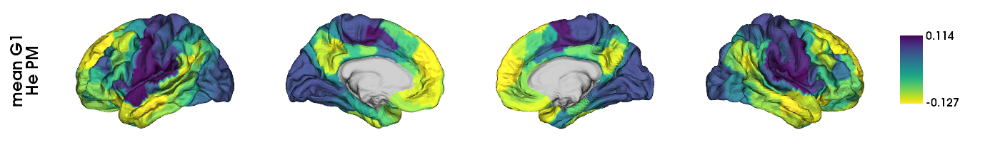

In [45]:
### Build mean gradient

# compute the mean connectivity matrix (by averaging the connectivity matrices of all subjects)
mean_fc_matrix_He_PM = sum(fc_matrices_He_PM)/len(fc_matrices_He_PM)


## compute the mean gradients 

# GradientMaps function used to build the model parameters
mean_fc_grad_He_PM = GradientMaps(n_components = 10, random_state = 0, approach = 'dm', kernel = 'normalized_angle')

# fit function used to compute the gradients
mean_fc_grad_He_PM.fit(mean_fc_matrix_He_PM)

# mean G1 -> flip mean G1 for it to be in the same direction as female G1
mean_fc_G1_He_PM = mean_fc_grad_He_PM.gradients_[:,0]*-1



### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network 
#And the only options for plotting in brainspace are either Schaefer 400 (7 networks) or fsaverage5

mean_fc_G1_He_PM_fs5 = schaefer400_to_fs5(schaefer400_data = mean_fc_G1_He_PM, seven_networks=False)



### Plot on hemispheres

# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = mean_fc_G1_He_PM_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'viridis_r', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["mean G1\nHe PM"],
    zoom = 1.45)

plotted_hemispheres

## Aligned gradients

In [46]:
compute_aligned_grad_He_PM = compute_aligned_gradients(fc_matrices_He_PM, mean_fc_grad_He_PM.gradients_*-1)  # *-1 to flip all the 10 mean gradients

# storing the output of the computation of the aligned gradients
#array_aligned_gradients = compute_aligned_grad['array_aligned_gradients']
array_aligned_fc_He_PM_G1 = compute_aligned_grad_He_PM['array_aligned_G1']

### Export gradient to csv for dispersion analyses

In [47]:
# fmt = decimals

np.savetxt(resdir+'array_aligned_fc_He_PM_G1.csv', array_aligned_fc_He_PM_G1, delimiter=',', fmt = '%.16g', header = '', comments = '')

## Variability in gradients

### Visualize daily gradients

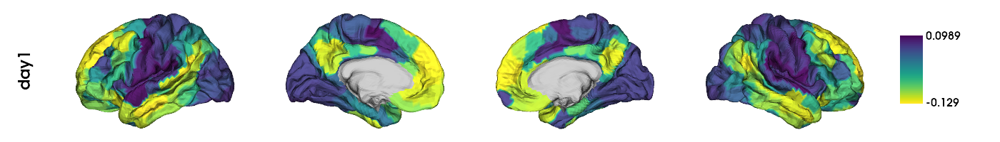

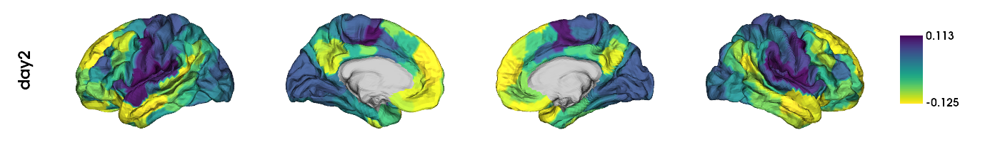

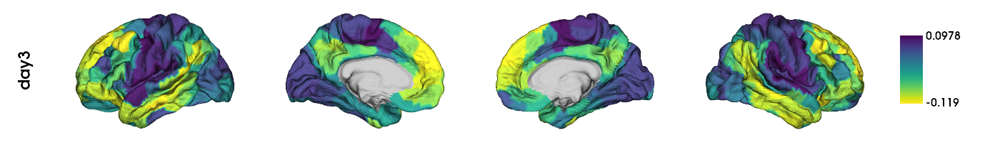

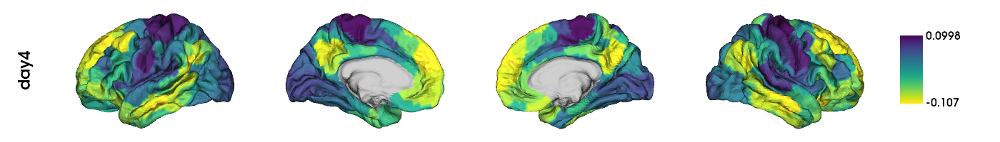

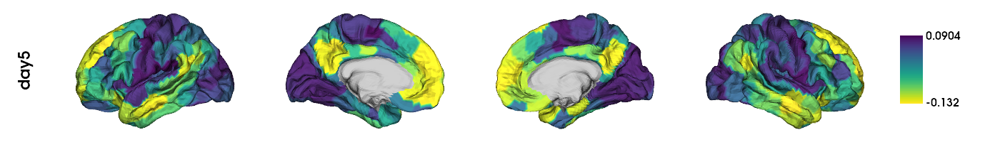

...

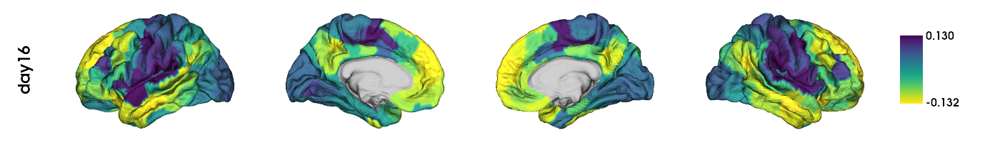

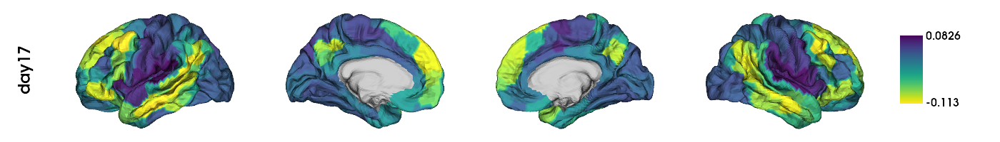

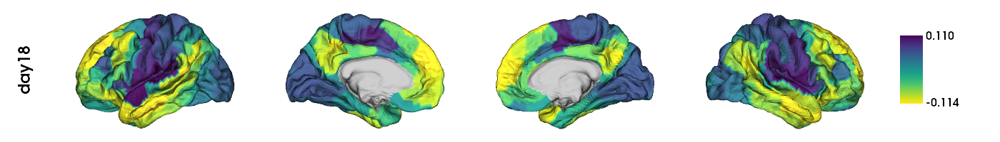

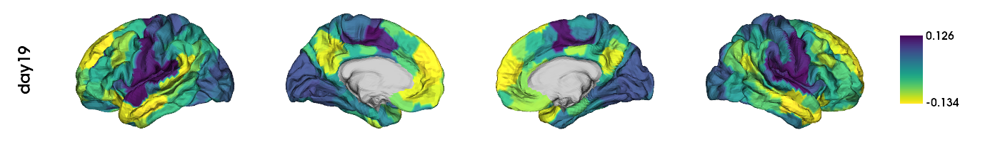

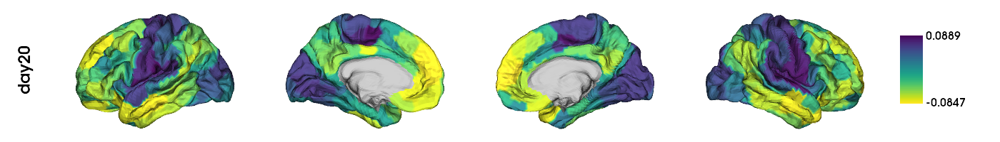

In [111]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


# define handles list to hold the 30 days data to plot on hemispheres
handles = []
    
    
# iterate over  MC cycle days
for i in range(len(array_aligned_fc_He_PM_G1)):
    
    # transform to fs5 for plotting
    fc_He_PM_G1_fs5 = schaefer400_to_fs5(schaefer400_data = array_aligned_fc_He_PM_G1[i], seven_networks=False)
    
    # plot on hemispheres
    plotted_hemispheres_byday = plot_hemispheres(
        surf_lh, 
        surf_rh, 
        array_name = fc_He_PM_G1_fs5, 
        embed_nb = True, 
        size = (1400,200), 
        cmap = 'viridis_r', 
        color_bar = True, 
        #color_range = color_range_t,
        nan_color = (0.7, 0.7, 0.7, 1),
        label_text = ["day"+str(i+1)],
        zoom = 1.45)

    # append current day to handles
    handles.append(plotted_hemispheres_byday)
    
# display handles
display(*handles)

### Quantify variability

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:292: UserWarning: Support for interactive mode is only provided for a single renderer: 'nrow=1' and 'ncol=1'. Setting 'interactive=False'
  warnings.warn("Support for interactive mode is only provided for "


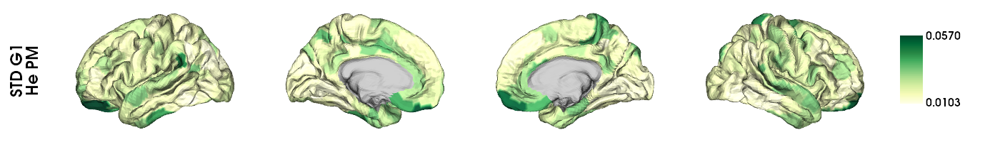

In [114]:
# compute the standard deviation across days per parcel
std_fc_He_PM_G1 = np.std(array_aligned_fc_He_PM_G1, axis=0)


## Plot

# convert to fs5 for plotting
std_fc_He_PM_G1_fs5 = schaefer400_to_fs5(schaefer400_data = std_fc_He_PM_G1, seven_networks=False)

# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


# plot hemispheres
plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = std_fc_He_PM_G1_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'YlGn', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["STD G1\nHe PM"],
    zoom = 1.45)

plotted_hemispheres

2023-09-22 17:05:10,565 - matplotlib.legend - WARNING - No handles with labels found to put in legend.


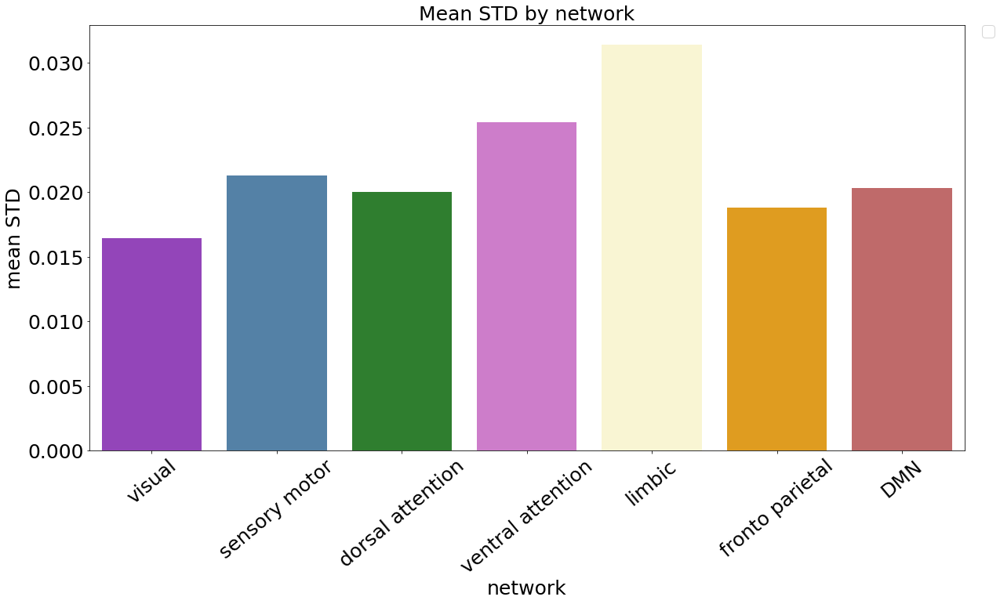

In [115]:
### Shape data in a plottable format

# lists that will contain std per sex per network
visual_std_grad = []
sensorimotor_std_grad = []
dorsalattention_std_grad = []
ventralattention_std_grad = []
limbic_std_grad = []
frontoparietal_std_grad = []
dmn_std_grad = []


# iterating over 400 parcels (of std) 
for i in range(len(std_fc_G1)):

    # append given parcel's std gradient loading to the corresponding list depending on what network it belongs to (and by sex)
    if yeo_17_2_7_networks_array_labels[i] == 'visual':
        visual_std_grad.append(std_fc_He_PM_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'sensory motor':
        sensorimotor_std_grad.append(std_fc_He_PM_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'dorsal attention':
        dorsalattention_std_grad.append(std_fc_He_PM_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'ventral attention':
        ventralattention_std_grad.append(std_fc_He_PM_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'limbic':
        limbic_std_grad.append(std_fc_He_PM_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'fronto parietal':
        frontoparietal_std_grad.append(std_fc_He_PM_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'DMN':
        dmn_std_grad.append(std_fc_He_PM_G1[i])
        
        

# shape specifically for sns plotting

dict_std_fc_G1 = {'visual': statistics.mean(visual_std_grad), 
                  'sensory motor': statistics.mean(sensorimotor_std_grad), 
                  'dorsal attention': statistics.mean(dorsalattention_std_grad), 
                  'ventral attention': statistics.mean(ventralattention_std_grad), 
                  'limbic': statistics.mean(limbic_std_grad),
                  'fronto parietal': statistics.mean(frontoparietal_std_grad), 
                  'DMN': statistics.mean(dmn_std_grad), 
                  'id': [1]*30}

df_std_fc_G1 = pd.DataFrame(dict_std_fc_G1)

df_std_fc_G1_long = pd.melt(df_std_fc_G1, id_vars=['id'], value_vars=['visual', 'sensory motor', 'dorsal attention', 'ventral attention', 'limbic', 'fronto parietal', 'DMN'], var_name='network', value_name='mean sd')



### Plot 

fig, ax = plt.subplots(figsize=(20,10));

ax = sns.barplot(data=df_std_fc_G1_long, x='network', y='mean sd', palette=palette_labeled_networks)


ax.set_title('Mean STD by network', fontsize=25);
ax.set_xlabel('network', fontsize=25);
ax.set_ylabel('mean STD', fontsize=25);
ax.tick_params(labelsize=25);

ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="center")
ax.legend(fontsize=20, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)


# Correlation mean gradients by sample

He (AM) vs He (PM)

In [124]:
stats.spearmanr(mean_fc_G1_He_AM, mean_fc_G1_He_PM)

SpearmanrResult(correlation=0.9452972831080193, pvalue=9.954252181968302e-196)

Me (excluding day 26) vs OC

In [122]:
stats.spearmanr(mean_fc_G1_excl26, mean_fc_G1_OC)

SpearmanrResult(correlation=0.9676607353795961, pvalue=3.53443808101889e-240)

Me vs He (AM)

In [123]:
stats.spearmanr(mean_fc_G1_excl26, mean_fc_G1_He_AM)

SpearmanrResult(correlation=0.7418590741192131, pvalue=4.4836074477019915e-71)

Me vs He (PM) -> I would have expected r(Me(AM), He(AM)) > r(Me(AM), PM)) given possible other biological/environmental factors making the connectome more similar at the same time of the day...

In [125]:
stats.spearmanr(mean_fc_G1_excl26, mean_fc_G1_He_PM)

SpearmanrResult(correlation=0.8400885005531283, pvalue=8.951836252923739e-108)

OC and He (AM)

In [126]:
stats.spearmanr(mean_fc_G1_OC, mean_fc_G1_He_AM)

SpearmanrResult(correlation=0.7508295051844073, pvalue=1.0806921924626735e-73)

OC and He (PM)

In [127]:
stats.spearmanr(mean_fc_G1_OC, mean_fc_G1_He_PM)

SpearmanrResult(correlation=0.8415931974574841, pvalue=1.6021969689918847e-108)

# Linear Mixed Model

using statsmodels package https://www.statsmodels.org/dev/generated/statsmodels.regression.mixed_linear_model.MixedLM.html#statsmodels.regression.mixed_linear_model.MixedLM

accessing results: https://www.statsmodels.org/dev/generated/statsmodels.regression.mixed_linear_model.MixedLMResults.html

## MixedLM (Me)

### Run model

In [53]:
lmer_res = {'parcel' : [], 'estradiol_t_val': [], 'estradiol_p_val': [], 'progesterone_t_val': [], 'progesterone_p_val': []}

for i in range(400):
    
    # define model
    model = sm.MixedLM(
        endog = array_aligned_fc_G1.T[i],  # dependent variable
        exog = pd.DataFrame({'estradiol': hormones_28Me.estradiol, 'progesterone': hormones_28Me.progesterone}),  # fixed effects (covariate)
        groups = hormones_28Me.Experiment, 
        exog_re = hormones_28Me.ExperimentDay,  # covariates random effects
        exog_vc=None)

    # fit model
    results = model.fit()
    #results.summary()
    
    # save results of estradiol, progesterone, estradiol*progesterone effects (via indices) 
    lmer_res['parcel'].append(i)
    lmer_res['estradiol_t_val'].append(results.tvalues['estradiol'])
    lmer_res['estradiol_p_val'].append(results.pvalues['estradiol'])
    lmer_res['progesterone_t_val'].append(results.tvalues['progesterone'])
    lmer_res['progesterone_p_val'].append(results.pvalues['progesterone']) 

lmer_res['estradiol_q_val'] = fdrcorrection(lmer_res['estradiol_p_val'], alpha=0.05)[1]
lmer_res['progesterone_q_val'] = fdrcorrection(lmer_res['progesterone_p_val'], alpha=0.05)[1]

lmer_res = pd.DataFrame(lmer_res)

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:1634: UserWarning: Random effects covariance is singular
  warnings.warn(msg)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2054: UserWarning: The random effects covariance matrix is singular.
  warnings.warn(_warn_cov_sing)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parame

In [54]:
results.summary()

<class 'statsmodels.iolib.summary2.Summary'>
"""
          Mixed Linear Model Regression Results
==========================================================
Model:              MixedLM   Dependent Variable:   y     
No. Observations:   30        Method:               REML  
No. Groups:         1         Scale:                0.0022
Min. group size:    30        Log-Likelihood:       inf   
Max. group size:    30        Converged:            Yes   
Mean group size:    30.0                                  
----------------------------------------------------------
                  Coef. Std.Err.   z   P>|z| [0.025 0.975]
----------------------------------------------------------
estradiol         0.000    0.000 1.727 0.084 -0.000  0.001
progesterone      0.002    0.001 1.475 0.140 -0.001  0.005
ExperimentDay Var 0.000                                   
==========================================================

"""

In [55]:
lmer_res

,parcel,estradiol_t_val,estradiol_p_val,progesterone_t_val,progesterone_p_val,estradiol_q_val,progesterone_q_val
0,0,1.655630,9.779680e-02,-0.016025,0.987215,0.144508,0.987215
1,1,1.053514,2.921054e-01,-1.142334,0.253315,0.359514,0.332217
2,2,1.743622,8.122509e-02,0.349416,0.726777,0.130392,0.781481
3,3,-1.782878,7.460618e-02,0.999521,0.317543,0.122809,0.399425
4,4,-0.902045,3.670331e-01,1.233351,0.217445,0.431804,0.292064
...,...,...,...,...,...,...,...
395,395,-5.209707,1.891395e-07,-1.826279,0.067808,0.000013,0.117927
396,396,-1.416910,1.565092e-01,0.591158,0.554415,0.213491,0.628232
397,397,-1.928687,5.376970e-02,-2.335430,0.019521,0.100913,0.053935
398,398,-2.177996,2.940634e-02,-1.726311,0.084292,0.080429,0.136762


In [56]:
np.where(np.array(lmer_res.estradiol_q_val) < 0.05)[0].shape

(104,)

In [57]:
np.where(np.array(lmer_res.progesterone_q_val) < 0.05)[0].shape

(109,)

In [58]:
np.isnan(lmer_res.estradiol_p_val).any()

False

### Reshape results for plotting

#### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network (used in brainspace plot hemispheres)

In [60]:
estradiol_t_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res.estradiol_t_val, seven_networks=False)
progesterone_t_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res.progesterone_t_val, seven_networks=False)
estradiol_q_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res.estradiol_q_val, seven_networks=False)
progesterone_q_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res.progesterone_q_val, seven_networks=False)

#### t-values for q < 0.05

In [61]:
## find t-values

# estradiol

estradiol_fdr_corrected_tvals_fs5 = []

for i in range(len(estradiol_q_val_fs5)):
    if estradiol_q_val_fs5[i] <= 0.05:
        estradiol_fdr_corrected_tvals_fs5.append(estradiol_t_val_fs5[i])
    else:
        estradiol_fdr_corrected_tvals_fs5.append(float('nan'))
        
estradiol_fdr_corrected_tvals_fs5 = np.array(estradiol_fdr_corrected_tvals_fs5)



# progesterone

progesterone_fdr_corrected_tvals_fs5 = []

for i in range(len(progesterone_q_val_fs5)):
    if progesterone_q_val_fs5[i] <= 0.05:
        progesterone_fdr_corrected_tvals_fs5.append(progesterone_t_val_fs5[i])
    else:
        progesterone_fdr_corrected_tvals_fs5.append(float('nan'))
        
progesterone_fdr_corrected_tvals_fs5 = np.array(progesterone_fdr_corrected_tvals_fs5)

### Plot on hemispheres

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:292: UserWarning: Support for interactive mode is only provided for a single renderer: 'nrow=1' and 'ncol=1'. Setting 'interactive=False'
  warnings.warn("Support for interactive mode is only provided for "


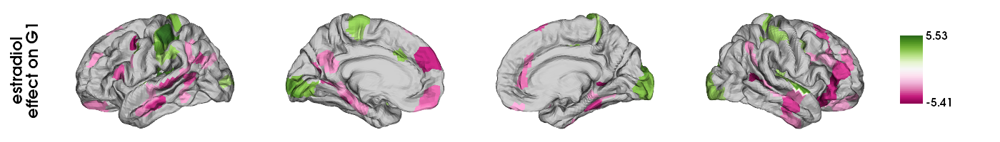

In [62]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = estradiol_fdr_corrected_tvals_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["estradiol\neffect on G1"],
    zoom = 1.45)

plotted_hemispheres

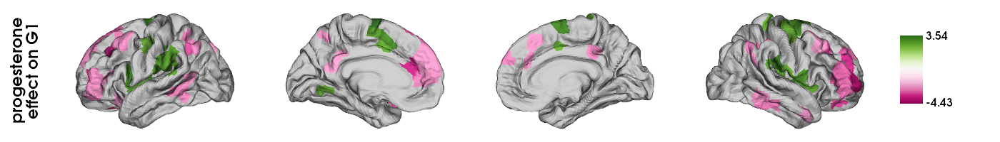

In [63]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = progesterone_fdr_corrected_tvals_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["progesterone\neffect on G1"],
    zoom = 1.45)

plotted_hemispheres

## MixedLM (Me) with Exclusion day 26

### Run model

In [162]:
lmer_res_excl26 = {'parcel' : [], 'estradiol_t_val': [], 'estradiol_p_val': [], 'progesterone_t_val': [], 'progesterone_p_val': []}

for i in range(400):
    
    # define model   
    model = sm.MixedLM(
        endog = array_aligned_fc_G1_excl26.T[i],  # dependent variable
        exog = pd.DataFrame({'estradiol': hormones_28Me_excl26.estradiol, 'progesterone': hormones_28Me_excl26.progesterone}),  # fixed effects (covariate)
        groups = hormones_28Me_excl26.Experiment, 
        exog_re = hormones_28Me_excl26.ExperimentDay,  # covariates random effects
        exog_vc=None)

    # fit model
    results = model.fit()
    #results.summary()
    
    # save results of estradiol, progesterone, estradiol*progesterone effects (via indices) 
    lmer_res_excl26['parcel'].append(i)
    lmer_res_excl26['estradiol_t_val'].append(results.tvalues['estradiol'])
    lmer_res_excl26['estradiol_p_val'].append(results.pvalues['estradiol'])
    lmer_res_excl26['progesterone_t_val'].append(results.tvalues['progesterone'])
    lmer_res_excl26['progesterone_p_val'].append(results.pvalues['progesterone']) 

lmer_res_excl26['estradiol_q_val'] = fdrcorrection(lmer_res_excl26['estradiol_p_val'], alpha=0.05)[1]
lmer_res_excl26['progesterone_q_val'] = fdrcorrection(lmer_res_excl26['progesterone_p_val'], alpha=0.05)[1]

lmer_res_excl26 = pd.DataFrame(lmer_res_excl26)

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:1634: UserWarning: Random effects covariance is singular
  warnings.warn(msg)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2054: UserWarning: The random effects covariance matrix is singular.
  warnings.warn(_warn_cov_sing)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parame

In [163]:
lmer_res_excl26

,parcel,estradiol_t_val,estradiol_p_val,progesterone_t_val,progesterone_p_val,estradiol_q_val,progesterone_q_val
0,0,0.942050,0.346167,-0.017877,0.985737,0.427367,0.988207
1,1,1.572749,0.115777,-1.104454,0.269396,0.196457,0.337801
2,2,0.827814,0.407776,0.312820,0.754418,0.488354,0.798351
3,3,-0.879658,0.379045,0.955937,0.339104,0.460845,0.416079
4,4,-1.214082,0.224716,1.254824,0.209543,0.311026,0.278462
...,...,...,...,...,...,...,...
395,395,-2.120987,0.033923,-2.143468,0.032076,0.154704,0.066600
396,396,-2.155734,0.031104,0.574651,0.565527,0.149711,0.639014
397,397,-1.737674,0.082268,-2.410591,0.015927,0.171250,0.043443
398,398,-1.873166,0.061045,-1.955555,0.050518,0.165800,0.092693


In [164]:
np.where(np.array(lmer_res_excl26.estradiol_q_val) < 0.05)[0].shape

(36,)

In [165]:
np.where(np.array(lmer_res_excl26.progesterone_q_val) < 0.05)[0].shape

(170,)

### Reshape results for plotting

#### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network (used in brainspace plot hemispheres)

In [70]:
estradiol_t_val_excl26_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_excl26.estradiol_t_val, seven_networks=False)
progesterone_t_val_excl26_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_excl26.progesterone_t_val, seven_networks=False)
estradiol_q_val_excl26_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_excl26.estradiol_q_val, seven_networks=False)
progesterone_q_val_excl26_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_excl26.progesterone_q_val, seven_networks=False)

#### t-values for q < 0.05

In [71]:
## find t-values

# estradiol

estradiol_fdr_corrected_tvals_excl26_fs5 = []

for i in range(len(estradiol_q_val_excl26_fs5)):
    if estradiol_q_val_excl26_fs5[i] <= 0.05:
        estradiol_fdr_corrected_tvals_excl26_fs5.append(estradiol_t_val_excl26_fs5[i])
    else:
        estradiol_fdr_corrected_tvals_excl26_fs5.append(float('nan'))
        
estradiol_fdr_corrected_tvals_excl26_fs5 = np.array(estradiol_fdr_corrected_tvals_excl26_fs5)



# progesterone

progesterone_fdr_corrected_tvals_excl26_fs5 = []

for i in range(len(progesterone_q_val_excl26_fs5)):
    if progesterone_q_val_excl26_fs5[i] <= 0.05:
        progesterone_fdr_corrected_tvals_excl26_fs5.append(progesterone_t_val_excl26_fs5[i])
    else:
        progesterone_fdr_corrected_tvals_excl26_fs5.append(float('nan'))
        
progesterone_fdr_corrected_tvals_excl26_fs5 = np.array(progesterone_fdr_corrected_tvals_excl26_fs5)

### Plot on hemispheres

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:292: UserWarning: Support for interactive mode is only provided for a single renderer: 'nrow=1' and 'ncol=1'. Setting 'interactive=False'
  warnings.warn("Support for interactive mode is only provided for "


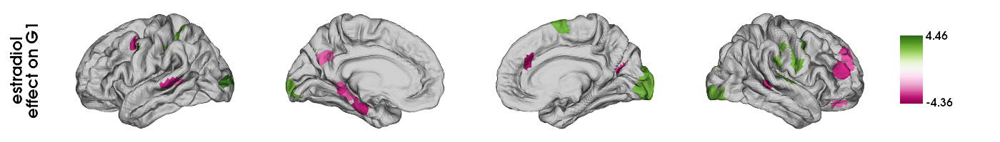

In [72]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = estradiol_fdr_corrected_tvals_excl26_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["estradiol\neffect on G1"],
    zoom = 1.45)

plotted_hemispheres

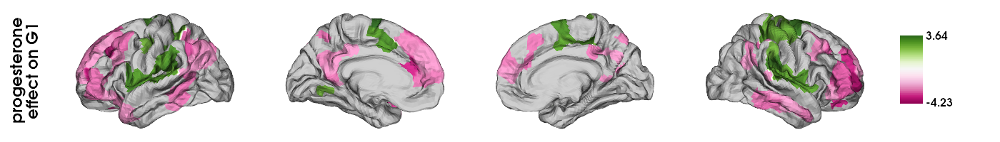

In [73]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = progesterone_fdr_corrected_tvals_excl26_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["progesterone\neffect on G1"],
    zoom = 1.45)

plotted_hemispheres

## MixedLM (OC)

### Run model

In [148]:
lmer_res_OC = {'parcel' : [], 'estradiol_t_val': [], 'estradiol_p_val': [], 'progesterone_t_val': [], 'progesterone_p_val': []}

for i in range(400):
    
    # define model
    model = sm.MixedLM(
        endog = array_aligned_fc_OC_G1.T[i],  # dependent variable
        exog = pd.DataFrame({'estradiol': hormones_28OC.estradiol, 'progesterone': hormones_28OC.progesterone}),  # fixed effects (covariate)
        groups = hormones_28OC.Experiment, 
        exog_re = hormones_28OC.ExperimentDay,  # covariates random effects
        exog_vc=None)

    # fit model
    results = model.fit()
    #results.summary()
    
    # save results of estradiol, progesterone, estradiol*progesterone effects (via indices) 
    lmer_res_OC['parcel'].append(i)
    lmer_res_OC['estradiol_t_val'].append(results.tvalues['estradiol'])
    lmer_res_OC['estradiol_p_val'].append(results.pvalues['estradiol'])
    lmer_res_OC['progesterone_t_val'].append(results.tvalues['progesterone'])
    lmer_res_OC['progesterone_p_val'].append(results.pvalues['progesterone']) 

lmer_res_OC['estradiol_q_val'] = fdrcorrection(lmer_res_OC['estradiol_p_val'], alpha=0.05)[1]
lmer_res_OC['progesterone_q_val'] = fdrcorrection(lmer_res_OC['progesterone_p_val'], alpha=0.05)[1]

lmer_res_OC = pd.DataFrame(lmer_res_OC)

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:1634: UserWarning: Random effects covariance is singular
  warnings.warn(msg)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2054: UserWarning: The random effects covariance matrix is singular.
  warnings.warn(_warn_cov_sing)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parame

In [149]:
lmer_res_OC

,parcel,estradiol_t_val,estradiol_p_val,progesterone_t_val,progesterone_p_val,estradiol_q_val,progesterone_q_val
0,0,-1.223871,0.221001,-0.100355,9.200626e-01,0.258418,9.293562e-01
1,1,1.592393,0.111296,-0.018900,9.849211e-01,0.141329,9.849211e-01
2,2,-1.016401,0.309439,1.247187,2.123289e-01,0.340042,2.301668e-01
3,3,-3.836963,0.000125,-1.330386,1.833913e-01,0.000272,2.009767e-01
4,4,-2.725930,0.006412,3.075401,2.102196e-03,0.010178,2.703789e-03
...,...,...,...,...,...,...,...
395,395,2.845247,0.004438,-8.267738,1.365248e-16,0.007308,2.730496e-16
396,396,1.356882,0.174819,-2.461347,1.384165e-02,0.209992,1.682875e-02
397,397,2.863774,0.004186,-8.947280,3.643500e-19,0.007006,7.835484e-19
398,398,3.501867,0.000462,-12.199339,3.133567e-34,0.000893,1.182478e-33


In [150]:
np.where(np.array(lmer_res_OC.estradiol_q_val) < 0.05)[0].shape

(287,)

In [157]:
np.where(np.array(lmer_res_OC.progesterone_q_val) < 0.05)[0].shape

(341,)

### Reshape results for plotting

#### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network (used in brainspace plot hemispheres)

In [151]:
estradiol_t_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_OC.estradiol_t_val, seven_networks=False)
progesterone_t_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_OC.progesterone_t_val, seven_networks=False)
estradiol_q_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_OC.estradiol_q_val, seven_networks=False)
progesterone_q_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_OC.progesterone_q_val, seven_networks=False)

#### t-values for q < 0.05

In [152]:
## find t-values

# estradiol

estradiol_fdr_corrected_tvals_fs5 = []

for i in range(len(estradiol_q_val_fs5)):
    if estradiol_q_val_fs5[i] <= 0.05:
        estradiol_fdr_corrected_tvals_fs5.append(estradiol_t_val_fs5[i])
    else:
        estradiol_fdr_corrected_tvals_fs5.append(float('nan'))
        
estradiol_fdr_corrected_tvals_fs5 = np.array(estradiol_fdr_corrected_tvals_fs5)



# progesterone

progesterone_fdr_corrected_tvals_fs5 = []

for i in range(len(progesterone_q_val_fs5)):
    if progesterone_q_val_fs5[i] <= 0.05:
        progesterone_fdr_corrected_tvals_fs5.append(progesterone_t_val_fs5[i])
    else:
        progesterone_fdr_corrected_tvals_fs5.append(float('nan'))
        
progesterone_fdr_corrected_tvals_fs5 = np.array(progesterone_fdr_corrected_tvals_fs5)

### Plot on hemispheres

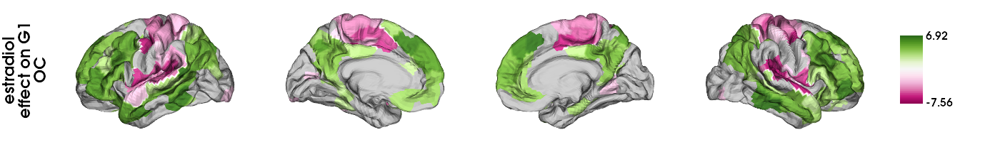

In [155]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = estradiol_fdr_corrected_tvals_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["estradiol\neffect on G1\nOC"],
    zoom = 1.45)

plotted_hemispheres

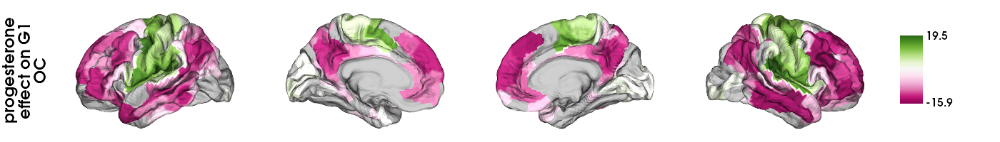

In [158]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = progesterone_fdr_corrected_tvals_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["progesterone\neffect on G1\nOC"],
    zoom = 1.45)

plotted_hemispheres

## Correlation estradiol effects Me and OC

In [166]:
stats.spearmanr(lmer_res_excl26.estradiol_t_val, lmer_res_OC.estradiol_t_val)

SpearmanrResult(correlation=-0.7557759735998348, pvalue=3.481461498056189e-75)

In [167]:
stats.spearmanr(lmer_res_excl26.progesterone_t_val, lmer_res_OC.progesterone_t_val)

SpearmanrResult(correlation=0.907440796504978, pvalue=5.901187844430054e-152)

## MixedLM (Me & OC in same model -> but each aligned to own mean gradients) 

### Concatenate hormonal data and gradient arrays in order to run LMM

In [101]:
hormones_28MeOC_MCreindexed = pd.concat([hormones_28Me_excl26_MCreindexed, hormones_28OC_MCreindexed])

array_aligned_fc_G1_Meexcl26_OC_MCreindexed = np.concatenate((array_aligned_fc_G1_excl26_MCreindexed, array_aligned_fc_OC_G1_MCreindexed))

In [142]:
hormones_28MeOC_MCreindexed

,Experiment,ExperimentDay,OpenNeuroSessionID,estradiol,progesterone,lh,fsh,CycleNotes,MC day
10,28andMe,11.0,11.0,31.70,0.630,5.21,7.82,menses,1
11,28andMe,12.0,12.0,22.90,0.280,5.29,7.85,menses,2
12,28andMe,13.0,13.0,21.80,0.170,6.42,7.27,menses,3
13,28andMe,14.0,14.0,36.70,0.084,5.04,7.12,menses,4
14,28andMe,15.0,15.0,26.70,0.056,6.16,7.19,NaN,5
15,28andMe,16.0,16.0,31.40,0.073,6.08,7.09,NaN,6
16,28andMe,17.0,17.0,34.30,0.045,7.01,6.17,NaN,7
17,28andMe,18.0,18.0,51.00,0.037,6.82,5.35,NaN,8
18,28andMe,19.0,19.0,47.90,0.075,5.25,4.63,NaN,9
19,28andMe,20.0,20.0,73.80,0.037,5.53,4.67,NaN,10


### Run model

In [137]:
lmer_res_Meexcl26_OC = {'parcel' : [], 'estradiol_t_val': [], 'estradiol_p_val': [], 'progesterone_t_val': [], 'progesterone_p_val': []}

for i in range(400):
    
    # define model   
    model = sm.MixedLM(
        endog = array_aligned_fc_G1_Meexcl26_OC_MCreindexed.T[i],  # dependent variable
        exog = pd.DataFrame({'estradiol': hormones_28MeOC_MCreindexed.estradiol, 'progesterone': hormones_28MeOC_MCreindexed.progesterone}),  # fixed effects (covariate)
        groups = hormones_28MeOC_MCreindexed.Experiment, 
        exog_re = hormones_28MeOC_MCreindexed['MC day'],  # covariates random effects -> INSTEAD OF Experimental Day
        exog_vc=None)

    # fit model
    results = model.fit()
    #results.summary()
    
    # save results of estradiol, progesterone, estradiol*progesterone effects (via indices) 
    lmer_res_Meexcl26_OC['parcel'].append(i)
    lmer_res_Meexcl26_OC['estradiol_t_val'].append(results.tvalues['estradiol'])
    lmer_res_Meexcl26_OC['estradiol_p_val'].append(results.pvalues['estradiol'])
    lmer_res_Meexcl26_OC['progesterone_t_val'].append(results.tvalues['progesterone'])
    lmer_res_Meexcl26_OC['progesterone_p_val'].append(results.pvalues['progesterone']) 

lmer_res_Meexcl26_OC['estradiol_q_val'] = fdrcorrection(lmer_res_Meexcl26_OC['estradiol_p_val'], alpha=0.05)[1]
lmer_res_Meexcl26_OC['progesterone_q_val'] = fdrcorrection(lmer_res_Meexcl26_OC['progesterone_p_val'], alpha=0.05)[1]

lmer_res_Meexcl26_OC = pd.DataFrame(lmer_res_Meexcl26_OC)

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:1634: UserWarning: Random effects covariance is singular
  warnings.warn(msg)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2054: UserWarning: The random effects covariance matrix is singular.
  warnings.warn(_warn_cov_sing)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parame

In [138]:
results.summary()

<class 'statsmodels.iolib.summary2.Summary'>
"""
         Mixed Linear Model Regression Results
=======================================================
Model:             MixedLM  Dependent Variable:  y     
No. Observations:  59       Method:              REML  
No. Groups:        2        Scale:               0.0035
Min. group size:   29       Log-Likelihood:      inf   
Max. group size:   30       Converged:           Yes   
Mean group size:   29.5                                
-------------------------------------------------------
             Coef.  Std.Err.   z    P>|z| [0.025 0.975]
-------------------------------------------------------
estradiol     0.000    0.000  1.855 0.064 -0.000  0.000
progesterone -0.005    0.003 -1.677 0.094 -0.010  0.001
MC day Var    0.000                                    
=======================================================

"""

In [139]:
lmer_res_Meexcl26_OC

,parcel,estradiol_t_val,estradiol_p_val,progesterone_t_val,progesterone_p_val,estradiol_q_val,progesterone_q_val
0,0,1.777680,0.075457,-0.453647,0.650083,0.101284,0.724326
1,1,3.938005,0.000082,0.479084,0.631879,0.003349,0.713987
2,2,1.485118,0.137513,-1.069738,0.284737,0.177436,0.565489
3,3,0.445708,0.655808,-0.108058,0.913950,0.686710,0.937385
4,4,0.330816,0.740783,-0.824331,0.409752,0.765667,0.601396
...,...,...,...,...,...,...,...
395,395,-3.204678,0.001352,1.492689,0.135518,0.004623,0.517779
396,396,-0.635350,0.525200,2.440814,0.014654,0.580332,0.517779
397,397,-3.153851,0.001611,1.318368,0.187381,0.004920,0.520804
398,398,-3.688695,0.000225,1.698183,0.089473,0.003575,0.517779


Random effect: MC day

In [140]:
np.where(np.array(lmer_res_Meexcl26_OC.estradiol_q_val) < 0.05)[0].shape

(276,)

In [141]:
np.where(np.array(lmer_res_Meexcl26_OC.progesterone_q_val) < 0.05)[0].shape

(0,)

Random effect: ExperimentDay not sure why results switch

In [104]:
np.where(np.array(lmer_res_Meexcl26_OC.estradiol_q_val) < 0.05)[0].shape

(0,)

In [105]:
np.where(np.array(lmer_res_Meexcl26_OC.progesterone_q_val) < 0.05)[0].shape

(268,)

### Reshape results for plotting

#### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network (used in brainspace plot hemispheres)

In [143]:
estradiol_t_val_Meexcl26_OC_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_Meexcl26_OC.estradiol_t_val, seven_networks=False)
progesterone_t_val_Meexcl26_OC_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_Meexcl26_OC.progesterone_t_val, seven_networks=False)
estradiol_q_val_Meexcl26_OC_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_Meexcl26_OC.estradiol_q_val, seven_networks=False)
progesterone_q_val_Meexcl26_OC_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_Meexcl26_OC.progesterone_q_val, seven_networks=False)

#### t-values for q < 0.05

In [145]:
## find t-values

# estradiol

estradiol_fdr_corrected_tvals_Meexcl26_OC_fs5 = []

for i in range(len(estradiol_q_val_Meexcl26_OC_fs5)):
    if estradiol_q_val_Meexcl26_OC_fs5[i] <= 0.05:
        estradiol_fdr_corrected_tvals_Meexcl26_OC_fs5.append(estradiol_t_val_Meexcl26_OC_fs5[i])
    else:
        estradiol_fdr_corrected_tvals_Meexcl26_OC_fs5.append(float('nan'))
        
estradiol_fdr_corrected_tvals_Meexcl26_OC_fs5 = np.array(estradiol_fdr_corrected_tvals_Meexcl26_OC_fs5)



# progesterone

progesterone_fdr_corrected_tvals_Meexcl26_OC_fs5 = []

for i in range(len(progesterone_q_val_Meexcl26_OC_fs5)):
    if progesterone_q_val_Meexcl26_OC_fs5[i] <= 0.05:
        progesterone_fdr_corrected_tvals_Meexcl26_OC_fs5.append(progesterone_t_val_Meexcl26_OC_fs5[i])
    else:
        progesterone_fdr_corrected_tvals_Meexcl26_OC_fs5.append(float('nan'))
        
progesterone_fdr_corrected_tvals_Meexcl26_OC_fs5 = np.array(progesterone_fdr_corrected_tvals_Meexcl26_OC_fs5)

### Plot on hemispheres

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:292: UserWarning: Support for interactive mode is only provided for a single renderer: 'nrow=1' and 'ncol=1'. Setting 'interactive=False'
  warnings.warn("Support for interactive mode is only provided for "


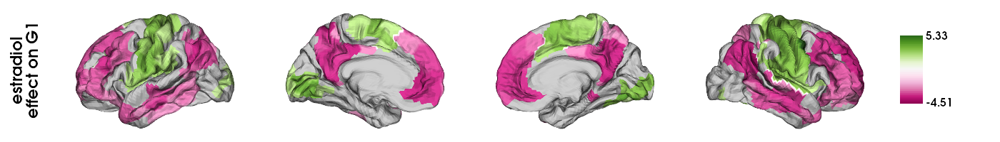

In [146]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = estradiol_fdr_corrected_tvals_Meexcl26_OC_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["estradiol\neffect on G1"],
    zoom = 1.45)

plotted_hemispheres

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/utils.py:303: RuntimeWarning: All-NaN axis encountered
  a, b = np.nanmin(x), np.nanmax(x)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/utils.py:367: RuntimeWarning: All-NaN slice encountered
  specs['min'][:] = np.nanmin(specs['min'], axis=ax, keepdims=True)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/utils.py:368: RuntimeWarning: All-NaN slice encountered
  specs['max'][:] = np.nanmax(specs['max'], axis=ax, keepdims=True)


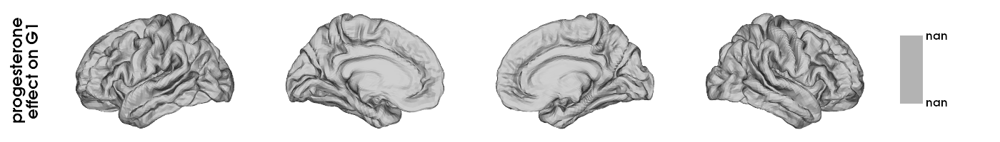

In [147]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = progesterone_fdr_corrected_tvals_Meexcl26_OC_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["progesterone\neffect on G1"],
    zoom = 1.45)

plotted_hemispheres

## MixedLM (He AM)

### Run model

In [128]:
lmer_res_He_AM = {'parcel' : [], 'testosterone_t_val': [], 'testosterone_p_val': [], 'cortisol_t_val': [], 'cortisol_p_val': []}

for i in range(400):
    
    # define model
    model = sm.MixedLM(
        endog = array_aligned_fc_He_AM_G1.T[i],  # dependent variable
        exog = pd.DataFrame({'testosterone': hormones_28He_AM.total_testosterone_saliva, 'cortisol': hormones_28He_AM.cortisol_saliva}),  # fixed effects (covariate)
        groups = hormones_28He_AM.time,  # the same across timepoints
        exog_re = hormones_28He_AM.session,  # covariates random effects
        exog_vc=None)

    # fit model
    results = model.fit()
    #results.summary()
    
    # save results of estradiol, progesterone, estradiol*progesterone effects (via indices) 
    lmer_res_He_AM['parcel'].append(i)
    lmer_res_He_AM['testosterone_t_val'].append(results.tvalues['testosterone'])
    lmer_res_He_AM['testosterone_p_val'].append(results.pvalues['testosterone'])
    lmer_res_He_AM['cortisol_t_val'].append(results.tvalues['cortisol'])
    lmer_res_He_AM['cortisol_p_val'].append(results.pvalues['cortisol']) 

lmer_res_He_AM['testosterone_q_val'] = fdrcorrection(lmer_res_He_AM['testosterone_p_val'], alpha=0.05)[1]
lmer_res_He_AM['cortisol_q_val'] = fdrcorrection(lmer_res_He_AM['cortisol_p_val'], alpha=0.05)[1]

lmer_res_He_AM = pd.DataFrame(lmer_res_He_AM)

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:1634: UserWarning: Random effects covariance is singular
  warnings.warn(msg)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2054: UserWarning: The random effects covariance matrix is singular.
  warnings.warn(_warn_cov_sing)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parame

In [129]:
lmer_res_He_AM

,parcel,testosterone_t_val,testosterone_p_val,cortisol_t_val,cortisol_p_val,testosterone_q_val,cortisol_q_val
0,0,5.588426,2.291366e-08,0.348341,0.727584,2.695724e-07,0.935191
1,1,5.976481,2.280096e-09,0.731329,0.464578,4.560193e-08,0.920364
2,2,0.471428,6.373350e-01,1.196516,0.231495,7.476070e-01,0.760980
3,3,2.625868,8.642844e-03,0.231795,0.816698,1.910021e-02,0.946859
4,4,2.792179,5.235445e-03,-0.543961,0.586468,1.217545e-02,0.920364
...,...,...,...,...,...,...,...
395,395,-6.348427,2.175272e-10,-0.432980,0.665029,6.215063e-09,0.925734
396,396,-2.541605,1.103449e-02,-1.614673,0.106381,2.360319e-02,0.567368
397,397,1.387509,1.652865e-01,-0.433920,0.664347,2.386809e-01,0.925734
398,398,-4.587593,4.483852e-06,-0.325397,0.744881,2.433713e-05,0.935191


In [130]:
np.where(np.array(lmer_res_He_AM.testosterone_q_val) < 0.05)[0].shape

(207,)

In [131]:
np.where(np.array(lmer_res_He_AM.cortisol_q_val) < 0.05)[0].shape

(0,)

### Reshape results for plotting

#### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network (used in brainspace plot hemispheres)

In [132]:
testosterone_t_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_He_AM.testosterone_t_val, seven_networks=False)
cortisol_t_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_He_AM.cortisol_t_val, seven_networks=False)
testosterone_q_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_He_AM.testosterone_q_val, seven_networks=False)
cortisol_q_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_He_AM.cortisol_q_val, seven_networks=False)

#### t-values for q < 0.05

In [133]:
## find t-values

# testosterone

testosterone_fdr_corrected_tvals_fs5 = []

for i in range(len(testosterone_q_val_fs5)):
    if testosterone_q_val_fs5[i] <= 0.05:
        testosterone_fdr_corrected_tvals_fs5.append(testosterone_t_val_fs5[i])
    else:
        testosterone_fdr_corrected_tvals_fs5.append(float('nan'))
        
testosterone_fdr_corrected_tvals_fs5 = np.array(testosterone_fdr_corrected_tvals_fs5)



# cortisol

cortisol_fdr_corrected_tvals_fs5 = []

for i in range(len(cortisol_q_val_fs5)):
    if cortisol_q_val_fs5[i] <= 0.05:
        cortisol_fdr_corrected_tvals_fs5.append(cortisol_t_val_fs5[i])
    else:
        cortisol_fdr_corrected_tvals_fs5.append(float('nan'))
        
cortisol_fdr_corrected_tvals_fs5 = np.array(cortisol_fdr_corrected_tvals_fs5)

### Plot on hemispheres

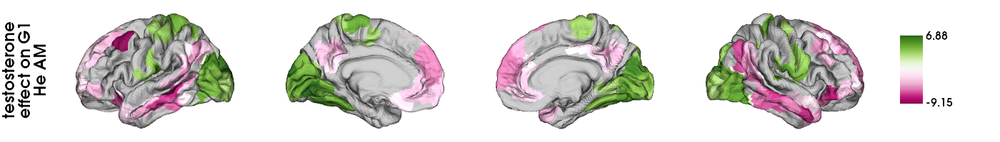

In [136]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = testosterone_fdr_corrected_tvals_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["testosterone\neffect on G1\nHe AM"],
    zoom = 1.45)

plotted_hemispheres

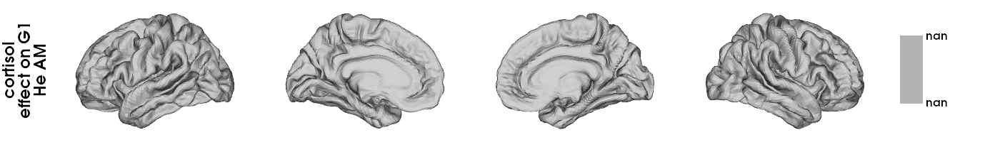

In [137]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = cortisol_fdr_corrected_tvals_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["cortisol\neffect on G1\nHe AM"],
    zoom = 1.45)

plotted_hemispheres

## MixedLM (He PM)

### Run model

In [48]:
lmer_res_He_PM = {'parcel' : [], 'testosterone_t_val': [], 'testosterone_p_val': [], 'cortisol_t_val': [], 'cortisol_p_val': []}

for i in range(400):
    
    # define model
    model = sm.MixedLM(
        endog = array_aligned_fc_He_PM_G1.T[i],  # dependent variable
        exog = pd.DataFrame({'testosterone': hormones_28He_PM.total_testosterone_saliva, 'cortisol': hormones_28He_PM.cortisol_saliva}),  # fixed effects (covariate)
        groups = hormones_28He_PM.time,  # the same across timepoints
        exog_re = hormones_28He_PM.session,  # covariates random effects
        exog_vc=None)

    # fit model
    results = model.fit()
    #results.summary()
    
    # save results of estradiol, progesterone, estradiol*progesterone effects (via indices) 
    lmer_res_He_PM['parcel'].append(i)
    lmer_res_He_PM['testosterone_t_val'].append(results.tvalues['testosterone'])
    lmer_res_He_PM['testosterone_p_val'].append(results.pvalues['testosterone'])
    lmer_res_He_PM['cortisol_t_val'].append(results.tvalues['cortisol'])
    lmer_res_He_PM['cortisol_p_val'].append(results.pvalues['cortisol']) 

lmer_res_He_PM['testosterone_q_val'] = fdrcorrection(lmer_res_He_PM['testosterone_p_val'], alpha=0.05)[1]
lmer_res_He_PM['cortisol_q_val'] = fdrcorrection(lmer_res_He_PM['cortisol_p_val'], alpha=0.05)[1]

lmer_res_He_PM = pd.DataFrame(lmer_res_He_PM)

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:1634: UserWarning: Random effects covariance is singular
  warnings.warn(msg)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2054: UserWarning: The random effects covariance matrix is singular.
  warnings.warn(_warn_cov_sing)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parame

In [49]:
for i in lmer_res_He_PM['testosterone_p_val']:
    print(i)

0.12367999922013578
0.08528188220217837
0.7529233073683357
0.00015784890896319986
0.8026573814130822
0.9999378845368542
0.055051738875838876
0.504359043867055
0.319172491629482
0.3819353065149994
nan
0.0921535304079499
0.11049185061876511
0.18922162757842398
0.283409237084558
0.24998339739520026
0.19637355506741583
nan
nan
0.14543889338369637
0.1826849394336545
0.9030806317980357
0.05256052547388671
0.10059986305312282
0.022493230376860837
0.14592234382404715
0.3400568631339833
0.2676811976431932
0.5156361188274619
0.1860767557614601
0.14592733209771458
0.05612963228718526
0.2047834972196667
0.3652989282502854
0.3009857429242264
0.08442387554139368
0.3203868789099027
0.5319470288013588
0.20685683248073838
0.3757256517221196
0.2477474687308734
0.21370888141882083
0.2589319490609159
0.04750872591100837
0.020770157574094332
0.024848932900014477
0.03323915641833602
0.3132254016564783
0.39204919495518686
0.08364494614057968
0.06602720679022461
0.02665433928711648
0.032694275259215914
0.0432

In [50]:
lmer_res_He_PM

,parcel,testosterone_t_val,testosterone_p_val,cortisol_t_val,cortisol_p_val,testosterone_q_val,cortisol_q_val
0,0,1.539509,0.123680,-0.109428,0.912863,NaN,NaN
1,1,1.720829,0.085282,0.808785,0.418639,NaN,NaN
2,2,0.314787,0.752923,3.919276,0.000089,NaN,NaN
3,3,3.778385,0.000158,0.923292,0.355855,NaN,NaN
4,4,0.249909,0.802657,2.127105,0.033411,NaN,NaN
...,...,...,...,...,...,...,...
395,395,-1.816825,0.069244,-0.261637,0.793601,NaN,NaN
396,396,-1.476989,0.139678,0.107284,0.914564,NaN,NaN
397,397,0.142392,0.886770,0.792202,0.428243,NaN,NaN
398,398,-3.056925,0.002236,-0.014174,0.988691,NaN,NaN


In [51]:
np.where(np.array(lmer_res_He_PM.testosterone_q_val) < 0.05)[0].shape

(0,)

In [52]:
np.where(np.array(lmer_res_He_PM.cortisol_q_val) < 0.05)[0].shape

(0,)

### Reshape results for plotting

#### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network (used in brainspace plot hemispheres)

In [142]:
testosterone_t_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_He_PM.testosterone_t_val, seven_networks=False)
cortisol_t_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_He_PM.cortisol_t_val, seven_networks=False)
testosterone_q_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_He_PM.testosterone_q_val, seven_networks=False)
cortisol_q_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_He_PM.cortisol_q_val, seven_networks=False)

#### t-values for q < 0.05

In [143]:
## find t-values

# testosterone

testosterone_fdr_corrected_tvals_fs5 = []

for i in range(len(testosterone_q_val_fs5)):
    if testosterone_q_val_fs5[i] <= 0.05:
        testosterone_fdr_corrected_tvals_fs5.append(testosterone_t_val_fs5[i])
    else:
        testosterone_fdr_corrected_tvals_fs5.append(float('nan'))
        
testosterone_fdr_corrected_tvals_fs5 = np.array(testosterone_fdr_corrected_tvals_fs5)



# cortisol

cortisol_fdr_corrected_tvals_fs5 = []

for i in range(len(cortisol_q_val_fs5)):
    if cortisol_q_val_fs5[i] <= 0.05:
        cortisol_fdr_corrected_tvals_fs5.append(cortisol_t_val_fs5[i])
    else:
        cortisol_fdr_corrected_tvals_fs5.append(float('nan'))
        
cortisol_fdr_corrected_tvals_fs5 = np.array(cortisol_fdr_corrected_tvals_fs5)

### Plot on hemispheres

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/utils.py:303: RuntimeWarning: All-NaN axis encountered
  a, b = np.nanmin(x), np.nanmax(x)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/utils.py:367: RuntimeWarning: All-NaN slice encountered
  specs['min'][:] = np.nanmin(specs['min'], axis=ax, keepdims=True)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/utils.py:368: RuntimeWarning: All-NaN slice encountered
  specs['max'][:] = np.nanmax(specs['max'], axis=ax, keepdims=True)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:292: UserWarning: Support for interactive mode is only provided for a single renderer: 'nrow=1' and 'ncol=1'. Setting 'interactive=False'
  warnings.warn("Support for interactive mode is only provided for "


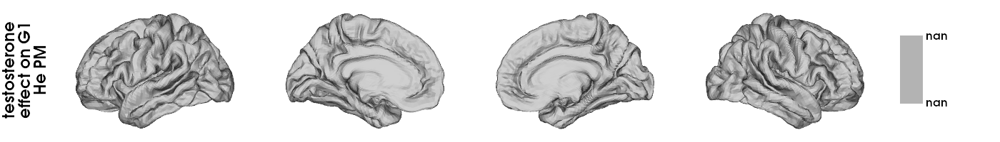

In [144]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = testosterone_fdr_corrected_tvals_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["testosterone\neffect on G1\nHe PM"],
    zoom = 1.45)

plotted_hemispheres

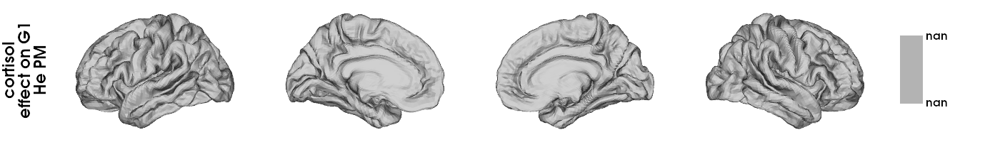

In [145]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = cortisol_fdr_corrected_tvals_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["cortisol\neffect on G1\nHe PM"],
    zoom = 1.45)

plotted_hemispheres

## Correlation estradiol effects He AM and PM

In [147]:
stats.spearmanr(lmer_res_He_AM.testosterone_t_val, lmer_res_He_PM.testosterone_t_val)

SpearmanrResult(correlation=nan, pvalue=nan)

In [148]:
stats.spearmanr(lmer_res_He_AM.cortisol_t_val, lmer_res_He_PM.cortisol_t_val)

SpearmanrResult(correlation=nan, pvalue=nan)

## From formula **RESULTS ARE STRANGE -> understand why / what is the difference between the LM function and with formula**

https://www.statsmodels.org/dev/generated/statsmodels.regression.mixed_linear_model.MixedLM.from_formula.html

In [155]:
lmer_res = {'parcel' : [], 'estradiol_t_val': [], 'estradiol_p_val': [], 'progesterone_t_val': [], 'progesterone_p_val': []}

for i in range(400):
    # make a dataframe that will contain the data for linear mixed effects model for each parcel
    lmer_df = pd.DataFrame({'G1': array_aligned_fc_G1.T[i], 'estradiol': hormones_28Me.estradiol, 'progesterone': hormones_28Me.progesterone,  'time': hormones_28Me.ExperimentDay, 'experiment': hormones_28Me.Experiment})

    # define model
    model = sm.MixedLM.from_formula(
        formula = "G1 ~ 1 + estradiol + progesterone", 
        data = lmer_df, 
        re_formula="1",
        groups="experiment",  # groups variable needed for MixedLM function - just giving it 1 value
        vc_formula={"time": "0 + C(time)"})  # random effect of time
    
    # fit model
    results = model.fit()
    #results.summary()
    
    # save results of estradiol, progesterone, estradiol*progesterone effects (via indices) 
    lmer_res['parcel'].append(i)
    lmer_res['estradiol_t_val'].append(results.tvalues['estradiol'])
    lmer_res['estradiol_p_val'].append(results.pvalues['estradiol'])
    lmer_res['progesterone_t_val'].append(results.tvalues['progesterone'])
    lmer_res['progesterone_p_val'].append(results.pvalues['progesterone'])

lmer_res['estradiol_q_val'] = fdrcorrection(lmer_res['estradiol_p_val'], alpha=0.05)[1]
lmer_res['progesterone_q_val'] = fdrcorrection(lmer_res['progesterone_p_val'], alpha=0.05)[1]

lmer_res = pd.DataFrame(lmer_res)

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/data/u_serio_software/anaconda3/lib/pyt

In [156]:
results.summary()

<class 'statsmodels.iolib.summary2.Summary'>
"""
          Mixed Linear Model Regression Results
=========================================================
Model:              MixedLM  Dependent Variable:  G1     
No. Observations:   30       Method:              REML   
No. Groups:         1        Scale:               0.0006 
Min. group size:    30       Log-Likelihood:      41.7755
Max. group size:    30       Converged:           Yes    
Mean group size:    30.0                                 
---------------------------------------------------------
               Coef.  Std.Err.   z    P>|z| [0.025 0.975]
---------------------------------------------------------
Intercept       0.098    0.027  3.576 0.000  0.044  0.151
estradiol       0.000    0.000  0.380 0.704 -0.000  0.000
progesterone   -0.001    0.001 -1.169 0.242 -0.003  0.001
experiment Var  0.001                                    
time Var        0.001   16.460                           
=========================================================

"""

In [154]:
results.tvalues['estradiol']

0.38025816777168153

In [148]:
lmer_res

,parcel,estradiol_t_val,estradiol_p_val,progesterone_t_val,progesterone_p_val,estradiol_q_val,progesterone_q_val
0,0,0.448452,0.653827,-0.704706,0.480993,0.984094,0.832889
1,1,1.106854,0.268357,-1.276699,0.201709,0.984094,0.681666
2,2,0.549699,0.582526,-0.451876,0.651358,0.984094,0.930229
3,3,-0.844811,0.398216,-0.073028,0.941784,0.984094,0.992411
4,4,-1.084624,0.278088,-0.330467,0.741047,0.984094,0.946495
...,...,...,...,...,...,...,...
395,395,-1.095314,0.273379,0.577449,0.563636,0.984094,0.865076
396,396,0.429843,0.667310,2.213004,0.026897,0.984094,0.467420
397,397,-0.061416,0.951028,1.094492,0.273739,0.992382,0.744869
398,398,-0.583242,0.559731,1.188080,0.234802,0.984094,0.700902


In [149]:
np.where(np.array(lmer_res.estradiol_q_val) < 0.05)[0].shape

(0,)

In [150]:
np.where(np.array(lmer_res.progesterone_q_val) < 0.05)[0].shape

(0,)

In [ ]:
z is t?

In [ ]:
lmer_WN_dispersion_sex_contrast_res = {'yeo_network' : ["visual", "sensory motor", "dorsal attention", "ventral attention", "limbic", "fronto parietal", "DMN"], 
                                 't_val': [],
                                 'p_val': []}


# iterate over the 7 yeo netwokrs
for i in range(7):
    
    # make a dataframe that will contain the data for linear mixed effects model (only change is the WN dispersion metric (1-7 networks)
    df = pd.DataFrame({'WN_dispersion': WN_dispersion[i], 'sex': HCP_demographics_cleaned_final.Gender, 'age': HCP_demographics_cleaned_final.Age_in_Yrs, 'tot_SA': HCP_demographics_cleaned_final.tot_SA, 'Family_ID': HCP_demographics_cleaned_final.Family_ID, 'TwinStatus': HCP_demographics_cleaned_final.TwinStatus})

    # define model
    model = sm.MixedLM.from_formula(
        formula = "WN_dispersion ~ 1 + sex + age + tot_SA", 
        data = df, 
        re_formula="1",
        groups="Family_ID",
        vc_formula={"TwinStatus": "0 + C(TwinStatus)"})  # random effect of TwinStatus nested in Family_ID
    
    # fit model
    results = model.fit()
    #results.summary()
    
    # save results of sex contrast (index = 1)
    lmer_WN_dispersion_sex_contrast_res['t_val'].append(results.tvalues[1])
    lmer_WN_dispersion_sex_contrast_res['p_val'].append(results.pvalues[1])
    
    
lmer_WN_dispersion_sex_contrast_res = pd.DataFrame(lmer_WN_dispersion_sex_contrast_res)
lmer_WN_dispersion_sex_contrast_res = lmer_WN_dispersion_sex_contrast_res.set_index('yeo_network')

# Dispersion Analyses (Me) (excluding day 26)

Definitions
- Within network dispersion was quantified as sum squared Euclidean distance of network nodes to the network centroid at individual level (higher value = wider distribution = more dispersion/less integration)
- Between network dispersion was calculated as the Euclidean distance between network centroids. 

Steps
- These metrics were calculated for each subject within the individualised, aligned gradient space. 
- We used linear models, correcting for head motion and sex, to estimate the association of age with network centroid position, within network dispersion and between network dispersion. 
- For each model, we computed a null distribution of age-related differences using 1000 spherical rotations of the original parcellation scheme, thereby ensuring that for each permutation of the null distribution the spatial autocorrelation was retained (Alexander-Bloch et al., 2018; Vasa, 2017). 
- To explore whether age related differences in dispersion were driven by a particular gradient, we examined the correlation between dispersion and subjects individual principal component loadings for the principal component of each gradient (e.g. the first principal component of a principal component analysis of the subject*gradient matrix for the first 3 gradients).

## Within-network integration/dispersion analysis

Within network dispersion is calculated as the sum squared of the Euclidean distances from each network node to the network centroid, and higher values represent a wider distribution of the network in the 1D gradient space, ie: a more dispersed network (=less integrated).

-> computed at the daily level

### Computing within dispersion metric

In [99]:
# compute for each experimental day and for each yeo network a) network centroid position; b) within network dispersion metric (higher value = wider distribution = more dispersion)

yeo_cog = []  # center of gravity (median) for given network (i.e., network centroid position) (7 x 29)
WN_dispersion = []  # Within network dispersion: sum squared Euclidean distance of network nodes to the network centroid at experimental day level (7 x 29)


# gradient values
g1 = array_aligned_fc_G1_excl26.T  # transpose to obtain shape (400 x 29) in order to access/index the relevant network nodes


# iterate over the 7 Yeo networks
for n in range(7):
    
    # identify the nodes of given Yeo network
    netNodes = np.where(yeo_17_2_7 == (n + 1))
    netNodes = np.squeeze(netNodes)
    
    # get the gradient loadings of the nodes of the given Yeo network, for each experimental day (shape: number of nodes in network x N)
    G1_net = g1[netNodes]
    
    
    ### identify the centroid / center of gravity (= median) of the given Yeo network for each experimental day (shape: N)
    yeo_cog_net = np.median(G1_net, axis=0)  
    yeo_cog.append(yeo_cog_net)
    
    
    ### within network dispersion: 1 within network dispersion value per experimental day (per network)
    
    # compute (per subject) the Eucledian distance between each gradient loading (in Yeo network) and that network's centroid
    dist_nodes_to_cog = G1_net - yeo_cog_net  # shape: number of nodes in network x N
    
    # take the sum of squares of this Eucledian distance 
    sum_of_squares = np.sum((dist_nodes_to_cog**2), axis = 0)  # shape: N
    
    # append to list
    WN_dispersion.append(sum_of_squares)
    
    
yeo_cog = np.array(yeo_cog)
WN_dispersion = np.array(WN_dispersion)

In [89]:
WN_dispersion.shape

(7, 29)

### Hormonal effects in within-network dispersion (linear mixed effects model)

using statsmodels package

from formula: https://www.statsmodels.org/dev/generated/statsmodels.regression.mixed_linear_model.MixedLM.from_formula.html

accessing results: https://www.statsmodels.org/dev/generated/statsmodels.regression.mixed_linear_model.MixedLMResults.html

In [90]:
lmer_WN_dispersion_hormonal_contrast_res = {'yeo_network' : ["visual", "sensory motor", "dorsal attention", "ventral attention", "limbic", "fronto parietal", "DMN"], 
                                 'estradiol_t_val': [], 'estradiol_p_val': [], 'progesterone_t_val': [], 'progesterone_p_val': []}


# iterate over the 7 yeo netwokrs
for i in range(7):
    
    # define model
    model = sm.MixedLM(
        endog = WN_dispersion[i],  # dependent variable
        exog = pd.DataFrame({'estradiol': hormones_28Me_excl26.estradiol, 'progesterone': hormones_28Me_excl26.progesterone}),  # fixed effects (covariate)
        groups = hormones_28Me_excl26.Experiment, 
        exog_re = hormones_28Me_excl26.ExperimentDay,  # covariates random effects
        exog_vc=None)

    # fit model
    results = model.fit()
    #results.summary()
    
    # save results of estradiol, progesterone, estradiol*progesterone effects (via indices) 
    lmer_WN_dispersion_hormonal_contrast_res['estradiol_t_val'].append(results.tvalues['estradiol'])
    lmer_WN_dispersion_hormonal_contrast_res['estradiol_p_val'].append(results.pvalues['estradiol'])
    lmer_WN_dispersion_hormonal_contrast_res['progesterone_t_val'].append(results.tvalues['progesterone'])
    lmer_WN_dispersion_hormonal_contrast_res['progesterone_p_val'].append(results.pvalues['progesterone']) 


lmer_WN_dispersion_hormonal_contrast_res = pd.DataFrame(lmer_WN_dispersion_hormonal_contrast_res)
lmer_WN_dispersion_hormonal_contrast_res = lmer_WN_dispersion_hormonal_contrast_res.set_index('yeo_network')

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:1634: UserWarning: Random effects covariance is singular
  warnings.warn(msg)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2054: UserWarning: The random effects covariance matrix is singular.
  warnings.warn(_warn_cov_sing)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parame

In [91]:
lmer_WN_dispersion_hormonal_contrast_res

,estradiol_t_val,estradiol_p_val,progesterone_t_val,progesterone_p_val
yeo_network,,,,
visual,3.056496,0.002239,1.140266,0.254176
sensory motor,1.482511,0.138204,2.535853,0.011217
dorsal attention,1.408451,0.158997,2.576203,0.009989
ventral attention,1.378703,0.167986,2.598089,0.009374
limbic,1.402547,0.160752,1.527946,0.126526
fronto parietal,1.016858,0.309221,0.854467,0.392846
DMN,0.141018,0.887855,1.515451,0.129658


## Between-network integration/dispersion analysis

Between network dispersion is the Euclidean distance between two network centroids, and higher values reflect greater distance (more dispersion / less integration) -> computed at the experimental day level

In [92]:
# compute the between network dispersion metric (Eucledian distance) only once for each pariwise network comparison, whilst keeping track what networks are being compared

BN_dispersion_hormonal_contrast_res = {'pairwise_comparison' : [], 'estradiol_t_val': [], 'estradiol_p_val': [], 'progesterone_t_val': [], 'progesterone_p_val': []}

# iterate over 7 Yeo networks
for n1 in range(7):
    
    for n2 in range(7):
        
        current_pairwise_comparison = [n1+1, n2+1]
        
        
        if n1!=n2 and [n1+1, n2+1] not in BN_dispersion_hormonal_contrast_res['pairwise_comparison'] and list(reversed([n1+1, n2+1])) not in BN_dispersion_hormonal_contrast_res['pairwise_comparison']:
            
            # append the pairwise comparison to dict
            BN_dispersion_hormonal_contrast_res['pairwise_comparison'].append(current_pairwise_comparison)
        
            # compute the distance between centroid of network 1 and centroid of network 2 and append it to dict (=BN_dispersion)
            BN_dispersion = yeo_cog[n1] - yeo_cog[n2]
            
            
            ### compute linear model for current pairwise between network dispersion (distance between centroids)
            
            # define model
            model = sm.MixedLM(
                endog = BN_dispersion,  # dependent variable
                exog = pd.DataFrame({'estradiol': hormones_28Me_excl26.estradiol, 'progesterone': hormones_28Me_excl26.progesterone}),  # fixed effects (covariate)
                groups = hormones_28Me_excl26.Experiment, 
                exog_re = hormones_28Me_excl26.ExperimentDay,  # covariates random effects
                exog_vc=None)

    
            # fit model
            results = model.fit()
            #results.summary()

            # save results of estradiol, progesterone, estradiol*progesterone effects (via indices) 
            BN_dispersion_hormonal_contrast_res['estradiol_t_val'].append(results.tvalues['estradiol'])
            BN_dispersion_hormonal_contrast_res['estradiol_p_val'].append(results.pvalues['estradiol'])
            BN_dispersion_hormonal_contrast_res['progesterone_t_val'].append(results.tvalues['progesterone'])
            BN_dispersion_hormonal_contrast_res['progesterone_p_val'].append(results.pvalues['progesterone']) 


BN_dispersion_hormonal_contrast_res = pd.DataFrame(BN_dispersion_hormonal_contrast_res)
BN_dispersion_hormonal_contrast_res = BN_dispersion_hormonal_contrast_res.set_index('pairwise_comparison')

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:1634: UserWarning: Random effects covariance is singular
  warnings.warn(msg)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2054: UserWarning: The random effects covariance matrix is singular.
  warnings.warn(_warn_cov_sing)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parame

In [93]:
# for better readability, rename the columns to the pairwise comparisons with Yeo network labels (instead of numbers)
new_comparison_names = []

for label in BN_dispersion_hormonal_contrast_res.index:
    
    n1 = None
    n2 = None
    
    if label[0] == 1:
        n1 = 'visual'
    elif label[0] == 2:
        n1 = 'sensory motor'
    elif label[0] == 3:
        n1 = 'dorsal attention'
    elif label[0] == 4:
        n1 = 'ventral attention'
    elif label[0] == 5:
        n1 = 'limbic'
    elif label[0] == 6:
        n1 = 'fronto parietal'
    elif label[0] == 7:
        n1 = 'DMN'
        
    if label[1] == 1:
        n2 = 'visual'
    elif label[1] == 2:
        n2 = 'sensory motor'
    elif label[1] == 3:
        n2 = 'dorsal attention'
    elif label[1] == 4:
        n2 = 'ventral attention'
    elif label[1] == 5:
        n2 = 'limbic'
    elif label[1] == 6:
        n2 = 'fronto parietal'
    elif label[1] == 7:
        n2 = 'DMN'
        
    new_comparison_names.append(n1+' - '+n2)    
    
    
    
# make new comparison names the index of the results dataframe
BN_dispersion_hormonal_contrast_res['new_comparison_names'] = new_comparison_names
BN_dispersion_hormonal_contrast_res = BN_dispersion_hormonal_contrast_res.set_index('new_comparison_names')
BN_dispersion_hormonal_contrast_res.index.name = 'pairwise_comparisons'

In [94]:
BN_dispersion_hormonal_contrast_res

,estradiol_t_val,estradiol_p_val,progesterone_t_val,progesterone_p_val
pairwise_comparisons,,,,
visual - sensory motor,-2.246985,0.024641,-2.460082,0.013891
visual - dorsal attention,2.448643,0.014340,-0.136359,0.891538
visual - ventral attention,-0.598819,0.549294,-2.972992,0.002949
visual - limbic,1.341763,0.179673,1.215842,0.224045
visual - fronto parietal,1.989505,0.046646,2.477658,0.013225
visual - DMN,2.074884,0.037997,2.011396,0.044284
sensory motor - dorsal attention,1.969200,0.048930,2.289623,0.022043
sensory motor - ventral attention,4.685629,0.000003,-1.433951,0.151586
sensory motor - limbic,1.831514,0.067024,2.205441,0.027423


## Null model analysis - spin permutation

For each model, we computed a null distribution of age-related differences using 1000 spherical rotations of the original parcellation scheme, thereby ensuring that for each permutation of the null distribution the spatial autocorrelation was retained (Alexander-Bloch et al., 2018; Vasa, 2017). 

### Compute the null distributions of t-values for the hormone contrasts in the within and between dispersion analyses

Computed by p28Me_spin_permutation_lmer_within_between_network_dispersion.py

### Load null distributions of t-values

In [138]:
WN_dispersion_perm_tval_estradiol_contrast_null_distr = pd.read_csv(resdir+'WN_dispersion_perm_tval_estradiol_contrast_null_distr.csv')
WN_dispersion_perm_tval_progesterone_contrast_null_distr = pd.read_csv(resdir+'WN_dispersion_perm_tval_progesterone_contrast_null_distr.csv')

BN_dispersion_perm_tval_estradiol_contrast_null_distr = pd.read_csv(resdir+'BN_dispersion_perm_tval_estradiol_contrast_null_distr.csv')
BN_dispersion_perm_tval_progesterone_contrast_null_distr = pd.read_csv(resdir+'BN_dispersion_perm_tval_progesterone_contrast_null_distr.csv')

### Compute the spin p-values 

#### Within Network dispersion

##### Estradiol

In [139]:
# by computing the percentile rank of our empirical t-value relative to the null distribution of t-values obtained via spin permutation (stats.percentileofscore)

spin_p_val = []
sig_post_bonferroni = []


# iterate across networks in order to compare the t-value for a given network to that network's null distribution of tvalues
for network in lmer_WN_dispersion_hormonal_contrast_res.index:
    
    # compute the percentile of our empirical t-value
    percentile_of_tval = stats.percentileofscore(a = WN_dispersion_perm_tval_estradiol_contrast_null_distr[network], score = lmer_WN_dispersion_hormonal_contrast_res.loc[network, 'estradiol_t_val'], kind='mean')/100
    
    
    
    # two-tailed test therefore if our empirical t-value is negative, left tail therefore simply obtain the percentile rank of our t-value
    if lmer_WN_dispersion_hormonal_contrast_res.loc[network, 'estradiol_t_val'] < 0:
        spin_p_val.append(round(percentile_of_tval, 3))
        
        # given that we make 7 comparisons, correct for multiple comparisons with bonferroni (new significance threshold: 0.05/7 = 0.007)
        if percentile_of_tval < 0.05/7:
            sig_post_bonferroni.append('sig')

        else:
            sig_post_bonferroni.append('not sig')
        
        
    
    # if  our empirical t-value is positive, right tail therefore take 1 - the percentile rank of our t-value
    else:
        spin_p_val.append(round(1 - percentile_of_tval, 3))
        
        # given that we make 7 comparisons, correct for multiple comparisons with bonferroni (new significance threshold: 0.05/7 = 0.007)
        if (1 - percentile_of_tval) < 0.05/7:
            sig_post_bonferroni.append('sig')

        else:
            sig_post_bonferroni.append('not sig')
    
    

# add the spin permutation p-value and bonferroni corrected significance to results df
lmer_WN_dispersion_hormonal_contrast_res['estradiol_spin_p_val'] = spin_p_val
lmer_WN_dispersion_hormonal_contrast_res['estradiol Bonferroni sig. (alpha = 0.007)'] = sig_post_bonferroni

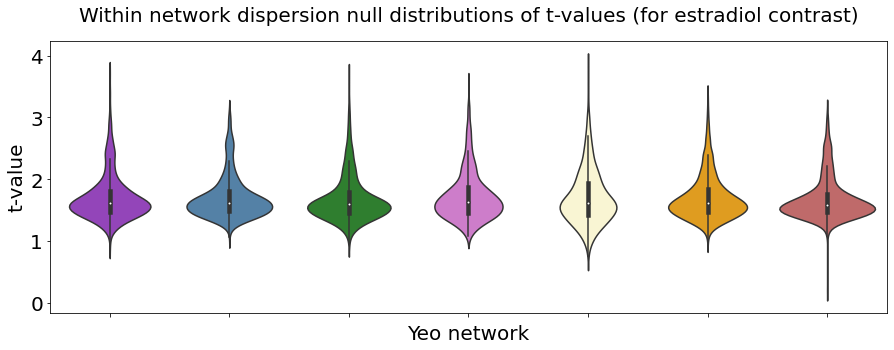

In [140]:
### Violin plot of t-values (null distributions) by Yeo network - in order to show where the empirical t-value is located

WN_dispersion_perm_tval_estradiol_contrast_null_distr_long = pd.melt(WN_dispersion_perm_tval_estradiol_contrast_null_distr, 
                                                               value_vars = WN_dispersion_perm_tval_estradiol_contrast_null_distr.columns.tolist(), 
                                                               var_name = 'yeo_network', value_name='t_vals', ignore_index=False)

fig, ax = plt.subplots(figsize=(15, 5))


sns.violinplot(data = WN_dispersion_perm_tval_estradiol_contrast_null_distr_long,
                    x="yeo_network",
                    y="t_vals",
                    #hue="",
                    palette = palette_labeled_networks,
                    split = False)

ax.axes.set_title("Within network dispersion null distributions of t-values (for estradiol contrast)", y=1.05, fontsize=20)
ax.set_xlabel("Yeo network",fontsize=20)
ax.set_ylabel("t-value",fontsize=20)
ax.tick_params(labelsize=20)
ax.set_xticklabels('', rotation=40, ha="right") 
#ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")  # to show tick labels

#plt.show()

# save figure in directory 
plt.savefig(resdir_fig+'violin_WN_dispersion_null_distr_tvals_estradiol.png', dpi=300, bbox_inches="tight")  # bbox_inches is so that the figure doesn't get cut off when savingb

##### Progesterone

In [141]:
# by computing the percentile rank of our empirical t-value relative to the null distribution of t-values obtained via spin permutation (stats.percentileofscore)

spin_p_val = []
sig_post_bonferroni = []


# iterate across networks in order to compare the t-value for a given network to that network's null distribution of tvalues
for network in lmer_WN_dispersion_hormonal_contrast_res.index:
    
    # compute the percentile of our empirical t-value
    percentile_of_tval = stats.percentileofscore(a = WN_dispersion_perm_tval_progesterone_contrast_null_distr[network], score = lmer_WN_dispersion_hormonal_contrast_res.loc[network, 'progesterone_t_val'], kind='mean')/100
    
    
    
    # two-tailed test therefore if our empirical t-value is negative, left tail therefore simply obtain the percentile rank of our t-value
    if lmer_WN_dispersion_hormonal_contrast_res.loc[network, 'progesterone_t_val'] < 0:
        spin_p_val.append(round(percentile_of_tval, 3))
        
        # given that we make 7 comparisons, correct for multiple comparisons with bonferroni (new significance threshold: 0.05/7 = 0.007)
        if percentile_of_tval < 0.05/7:
            sig_post_bonferroni.append('sig')

        else:
            sig_post_bonferroni.append('not sig')
        
        
    
    # if  our empirical t-value is positive, right tail therefore take 1 - the percentile rank of our t-value
    else:
        spin_p_val.append(round(1 - percentile_of_tval, 3))
        
        # given that we make 7 comparisons, correct for multiple comparisons with bonferroni (new significance threshold: 0.05/7 = 0.007)
        if (1 - percentile_of_tval) < 0.05/7:
            sig_post_bonferroni.append('sig')

        else:
            sig_post_bonferroni.append('not sig')
    
    

# add the spin permutation p-value and bonferroni corrected significance to results df
lmer_WN_dispersion_hormonal_contrast_res['progesterone_spin_p_val'] = spin_p_val
lmer_WN_dispersion_hormonal_contrast_res['progesterone Bonferroni sig. (alpha = 0.007)'] = sig_post_bonferroni

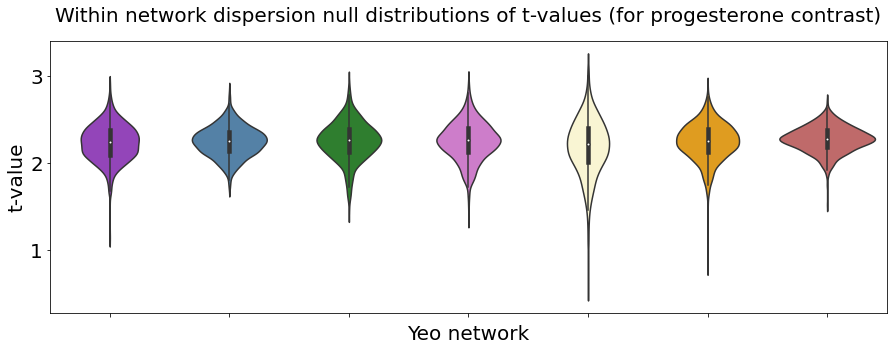

In [142]:
### Violin plot of t-values (null distributions) by Yeo network - in order to show where the empirical t-value is located

WN_dispersion_perm_tval_progesterone_contrast_null_distr_long = pd.melt(WN_dispersion_perm_tval_progesterone_contrast_null_distr, 
                                                               value_vars = WN_dispersion_perm_tval_progesterone_contrast_null_distr.columns.tolist(), 
                                                               var_name = 'yeo_network', value_name='t_vals', ignore_index=False)

fig, ax = plt.subplots(figsize=(15, 5))


sns.violinplot(data = WN_dispersion_perm_tval_progesterone_contrast_null_distr_long,
                    x="yeo_network",
                    y="t_vals",
                    #hue="",
                    palette = palette_labeled_networks,
                    split = False)

ax.axes.set_title("Within network dispersion null distributions of t-values (for progesterone contrast)", y=1.05, fontsize=20)
ax.set_xlabel("Yeo network",fontsize=20)
ax.set_ylabel("t-value",fontsize=20)
ax.tick_params(labelsize=20)
ax.set_xticklabels('', rotation=40, ha="right") 
#ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")  # to show tick labels

#plt.show()

# save figure in directory 
plt.savefig(resdir_fig+'violin_WN_dispersion_null_distr_tvals_progesterone.png', dpi=300, bbox_inches="tight")  # bbox_inches is so that the figure doesn't get cut off when savingb

##### Results

In [143]:
lmer_WN_dispersion_hormonal_contrast_res

,estradiol_t_val,estradiol_p_val,progesterone_t_val,progesterone_p_val,estradiol_spin_p_val,estradiol Bonferroni sig. (alpha = 0.007),progesterone_spin_p_val,progesterone Bonferroni sig. (alpha = 0.007)
yeo_network,,,,,,,,
visual,3.056496,0.002239,1.140266,0.254176,0.006,sig,0.999,not sig
sensory motor,1.482511,0.138204,2.535853,0.011217,0.741,not sig,0.045,not sig
dorsal attention,1.408451,0.158997,2.576203,0.009989,0.814,not sig,0.061,not sig
ventral attention,1.378703,0.167986,2.598089,0.009374,0.860,not sig,0.052,not sig
limbic,1.402547,0.160752,1.527946,0.126526,0.763,not sig,0.970,not sig
fronto parietal,1.016858,0.309221,0.854467,0.392846,0.999,not sig,0.999,not sig
DMN,0.141018,0.887855,1.515451,0.129658,1.000,not sig,1.000,not sig


#### Between Network dispersion

In [144]:
# for better readability, rename the columns to the pairwise comparisons with Yeo network labels (instead of numbers)
new_col_names = []

for label in BN_dispersion_perm_tval_estradiol_contrast_null_distr.columns:
    
    n1 = None
    n2 = None
    
    if label[1] == '1':
        n1 = 'visual'
    elif label[1] == '2':
        n1 = 'sensory motor'
    elif label[1] == '3':
        n1 = 'dorsal attention'
    elif label[1] == '4':
        n1 = 'ventral attention'
    elif label[1] == '5':
        n1 = 'limbic'
    elif label[1] == '6':
        n1 = 'fronto parietal'
    elif label[1] == '7':
        n1 = 'DMN'
        
    if label[4] == '1':
        n2 = 'visual'
    elif label[4] == '2':
        n2 = 'sensory motor'
    elif label[4] == '3':
        n2 = 'dorsal attention'
    elif label[4] == '4':
        n2 = 'ventral attention'
    elif label[4] == '5':
        n2 = 'limbic'
    elif label[4] == '6':
        n2 = 'fronto parietal'
    elif label[4] == '7':
        n2 = 'DMN'
        
    new_col_names.append(n1+' - '+n2)    
    
    
BN_dispersion_perm_tval_estradiol_contrast_null_distr.columns = new_col_names
BN_dispersion_perm_tval_progesterone_contrast_null_distr.columns = new_col_names

##### Estradiol

In [145]:
# by computing the percentile rank of our empirical t-value relative to the null distribution of t-values obtained via spin permutation (stats.percentileofscore)

spin_p_val = []
sig_post_bonferroni = []


# iterate across pairwise comparisons in order to compare the t-value for a given pairwise comparison to that pairwise comparison's null distribution of tvalues
for pairwise_comparison in BN_dispersion_hormonal_contrast_res.index:
    
    # compute the percentile of our empirical t-value
    percentile_of_tval = stats.percentileofscore(a = BN_dispersion_perm_tval_estradiol_contrast_null_distr[pairwise_comparison], score = BN_dispersion_hormonal_contrast_res.loc[pairwise_comparison, 'estradiol_t_val'], kind='mean')/100
    
    
    
    # two-tailed test therefore if our empirical t-value is negative, left tail therefore simply obtain the percentile rank of our t-value
    if BN_dispersion_hormonal_contrast_res.loc[pairwise_comparison, 'estradiol_t_val'] < 0:
        spin_p_val.append(round(percentile_of_tval, 3))
        
        # given that we make 21 comparisons, correct for multiple comparisons with bonferroni (new significance threshold: 0.05/21 = 0.002)
        if percentile_of_tval < 0.05/21:
            sig_post_bonferroni.append('sig')

        else:
            sig_post_bonferroni.append('not sig')
        
        
    
    # if  our empirical t-value is positive, right tail therefore take 1 - the percentile rank of our t-value
    else:
        spin_p_val.append(round(1 - percentile_of_tval, 3))
        
        # given that we make 21 comparisons, correct for multiple comparisons with bonferroni (new significance threshold: 0.05/21 = 0.002)
        if (1 - percentile_of_tval) < 0.05/21:
            sig_post_bonferroni.append('sig')

        else:
            sig_post_bonferroni.append('not sig')
    
    

# add the spin permutation p-value and bonferroni corrected significance to results df
BN_dispersion_hormonal_contrast_res['estradiol_spin_p_val'] = spin_p_val
BN_dispersion_hormonal_contrast_res['estradiol Bonferroni sig. (alpha = 0.002)'] = sig_post_bonferroni

##### Progesterone

In [146]:
# by computing the percentile rank of our empirical t-value relative to the null distribution of t-values obtained via spin permutation (stats.percentileofscore)

spin_p_val = []
sig_post_bonferroni = []


# iterate across pairwise comparisons in order to compare the t-value for a given pairwise comparison to that pairwise comparison's null distribution of tvalues
for pairwise_comparison in BN_dispersion_hormonal_contrast_res.index:
    
    # compute the percentile of our empirical t-value
    percentile_of_tval = stats.percentileofscore(a = BN_dispersion_perm_tval_progesterone_contrast_null_distr[pairwise_comparison], score = BN_dispersion_hormonal_contrast_res.loc[pairwise_comparison, 'progesterone_t_val'], kind='mean')/100
    
    
    
    # two-tailed test therefore if our empirical t-value is negative, left tail therefore simply obtain the percentile rank of our t-value
    if BN_dispersion_hormonal_contrast_res.loc[pairwise_comparison, 'progesterone_t_val'] < 0:
        spin_p_val.append(round(percentile_of_tval, 3))
        
        # given that we make 21 comparisons, correct for multiple comparisons with bonferroni (new significance threshold: 0.05/21 = 0.002)
        if percentile_of_tval < 0.05/21:
            sig_post_bonferroni.append('sig')

        else:
            sig_post_bonferroni.append('not sig')
        
        
    
    # if  our empirical t-value is positive, right tail therefore take 1 - the percentile rank of our t-value
    else:
        spin_p_val.append(round(1 - percentile_of_tval, 3))
        
        # given that we make 21 comparisons, correct for multiple comparisons with bonferroni (new significance threshold: 0.05/21 = 0.002)
        if (1 - percentile_of_tval) < 0.05/21:
            sig_post_bonferroni.append('sig')

        else:
            sig_post_bonferroni.append('not sig')
    
    

# add the spin permutation p-value and bonferroni corrected significance to results df
BN_dispersion_hormonal_contrast_res['progesterone_spin_p_val'] = spin_p_val
BN_dispersion_hormonal_contrast_res['progesterone Bonferroni sig. (alpha = 0.002)'] = sig_post_bonferroni

In [147]:
BN_dispersion_hormonal_contrast_res

,estradiol_t_val,estradiol_p_val,progesterone_t_val,progesterone_p_val,estradiol_spin_p_val,estradiol Bonferroni sig. (alpha = 0.002),progesterone_spin_p_val,progesterone Bonferroni sig. (alpha = 0.002)
pairwise_comparisons,,,,,,,,
visual - sensory motor,-2.246985,0.024641,-2.460082,0.013891,0.126,not sig,0.081,not sig
visual - dorsal attention,2.448643,0.014340,-0.136359,0.891538,0.052,not sig,0.544,not sig
visual - ventral attention,-0.598819,0.549294,-2.972992,0.002949,0.448,not sig,0.018,not sig
visual - limbic,1.341763,0.179673,1.215842,0.224045,0.276,not sig,0.340,not sig
visual - fronto parietal,1.989505,0.046646,2.477658,0.013225,0.147,not sig,0.081,not sig
visual - DMN,2.074884,0.037997,2.011396,0.044284,0.121,not sig,0.195,not sig
sensory motor - dorsal attention,1.969200,0.048930,2.289623,0.022043,0.158,not sig,0.092,not sig
sensory motor - ventral attention,4.685629,0.000003,-1.433951,0.151586,0.004,not sig,0.242,not sig
sensory motor - limbic,1.831514,0.067024,2.205441,0.027423,0.192,not sig,0.155,not sig


# Dispersion Analyses (OC)

Definitions
- Within network dispersion was quantified as sum squared Euclidean distance of network nodes to the network centroid at individual level (higher value = wider distribution = more dispersion/less integration)
- Between network dispersion was calculated as the Euclidean distance between network centroids. 

Steps
- These metrics were calculated for each subject within the individualised, aligned gradient space. 
- We used linear models, correcting for head motion and sex, to estimate the association of age with network centroid position, within network dispersion and between network dispersion. 
- For each model, we computed a null distribution of age-related differences using 1000 spherical rotations of the original parcellation scheme, thereby ensuring that for each permutation of the null distribution the spatial autocorrelation was retained (Alexander-Bloch et al., 2018; Vasa, 2017). 
- To explore whether age related differences in dispersion were driven by a particular gradient, we examined the correlation between dispersion and subjects individual principal component loadings for the principal component of each gradient (e.g. the first principal component of a principal component analysis of the subject*gradient matrix for the first 3 gradients).

## Within-network integration/dispersion analysis

Within network dispersion is calculated as the sum squared of the Euclidean distances from each network node to the network centroid, and higher values represent a wider distribution of the network in the 1D gradient space, ie: a more dispersed network (=less integrated).

-> computed at the daily level

### Computing within dispersion metric

In [177]:
# compute for each experimental day and for each yeo network a) network centroid position; b) within network dispersion metric (higher value = wider distribution = more dispersion)

yeo_cog = []  # center of gravity (median) for given network (i.e., network centroid position) (7 x 29)
WN_dispersion = []  # Within network dispersion: sum squared Euclidean distance of network nodes to the network centroid at experimental day level (7 x 29)


# gradient values
g1 = array_aligned_fc_OC_G1.T  # transpose to obtain shape (400 x 30) in order to access/index the relevant network nodes


# iterate over the 7 Yeo networks
for n in range(7):
    
    # identify the nodes of given Yeo network
    netNodes = np.where(yeo_17_2_7 == (n + 1))
    netNodes = np.squeeze(netNodes)
    
    # get the gradient loadings of the nodes of the given Yeo network, for each experimental day (shape: number of nodes in network x N)
    G1_net = g1[netNodes]
    
    
    ### identify the centroid / center of gravity (= median) of the given Yeo network for each experimental day (shape: N)
    yeo_cog_net = np.median(G1_net, axis=0)  
    yeo_cog.append(yeo_cog_net)
    
    
    ### within network dispersion: 1 within network dispersion value per experimental day (per network)
    
    # compute (per subject) the Eucledian distance between each gradient loading (in Yeo network) and that network's centroid
    dist_nodes_to_cog = G1_net - yeo_cog_net  # shape: number of nodes in network x N
    
    # take the sum of squares of this Eucledian distance 
    sum_of_squares = np.sum((dist_nodes_to_cog**2), axis = 0)  # shape: N
    
    # append to list
    WN_dispersion.append(sum_of_squares)
    
    
yeo_cog = np.array(yeo_cog)
WN_dispersion = np.array(WN_dispersion)

In [178]:
WN_dispersion.shape

(7, 30)

### Hormonal effects in within-network dispersion (linear mixed effects model)

using statsmodels package

from formula: https://www.statsmodels.org/dev/generated/statsmodels.regression.mixed_linear_model.MixedLM.from_formula.html

accessing results: https://www.statsmodels.org/dev/generated/statsmodels.regression.mixed_linear_model.MixedLMResults.html

In [179]:
lmer_WN_dispersion_OC_hormonal_contrast_res = {'yeo_network' : ["visual", "sensory motor", "dorsal attention", "ventral attention", "limbic", "fronto parietal", "DMN"], 
                                 'estradiol_t_val': [], 'estradiol_p_val': [], 'progesterone_t_val': [], 'progesterone_p_val': []}


# iterate over the 7 yeo netwokrs
for i in range(7):
    
    # define model
    model = sm.MixedLM(
        endog = WN_dispersion[i],  # dependent variable
        exog = pd.DataFrame({'estradiol': hormones_28OC.estradiol, 'progesterone': hormones_28OC.progesterone}),  # fixed effects (covariate)
        groups = hormones_28OC.Experiment, 
        exog_re = hormones_28OC.ExperimentDay,  # covariates random effects
        exog_vc=None)

    # fit model
    results = model.fit()
    #results.summary()
    
    # save results of estradiol, progesterone, estradiol*progesterone effects (via indices) 
    lmer_WN_dispersion_OC_hormonal_contrast_res['estradiol_t_val'].append(results.tvalues['estradiol'])
    lmer_WN_dispersion_OC_hormonal_contrast_res['estradiol_p_val'].append(results.pvalues['estradiol'])
    lmer_WN_dispersion_OC_hormonal_contrast_res['progesterone_t_val'].append(results.tvalues['progesterone'])
    lmer_WN_dispersion_OC_hormonal_contrast_res['progesterone_p_val'].append(results.pvalues['progesterone']) 


lmer_WN_dispersion_OC_hormonal_contrast_res = pd.DataFrame(lmer_WN_dispersion_OC_hormonal_contrast_res)
lmer_WN_dispersion_OC_hormonal_contrast_res = lmer_WN_dispersion_OC_hormonal_contrast_res.set_index('yeo_network')

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:1634: UserWarning: Random effects covariance is singular
  warnings.warn(msg)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2054: UserWarning: The random effects covariance 

In [180]:
lmer_WN_dispersion_OC_hormonal_contrast_res

,estradiol_t_val,estradiol_p_val,progesterone_t_val,progesterone_p_val
yeo_network,,,,
visual,-3.514412,0.000441,6.127117,8.948560e-10
sensory motor,-0.390460,0.696196,6.313803,2.722608e-10
dorsal attention,-3.438074,0.000586,7.699521,1.365772e-14
ventral attention,-0.770019,0.441289,7.454021,9.053756e-14
limbic,-2.250939,0.024389,5.419861,5.964539e-08
fronto parietal,-1.375149,0.169085,3.053023,2.265484e-03
DMN,0.348991,0.727096,3.771603,1.622019e-04


## Between-network integration/dispersion analysis

Between network dispersion is the Euclidean distance between two network centroids, and higher values reflect greater distance (more dispersion / less integration) -> computed at the experimental day level

In [181]:
# compute the between network dispersion metric (Eucledian distance) only once for each pariwise network comparison, whilst keeping track what networks are being compared

BN_dispersion_OC_hormonal_contrast_res = {'pairwise_comparison' : [], 'estradiol_t_val': [], 'estradiol_p_val': [], 'progesterone_t_val': [], 'progesterone_p_val': []}

# iterate over 7 Yeo networks
for n1 in range(7):
    
    for n2 in range(7):
        
        current_pairwise_comparison = [n1+1, n2+1]
        
        
        if n1!=n2 and [n1+1, n2+1] not in BN_dispersion_OC_hormonal_contrast_res['pairwise_comparison'] and list(reversed([n1+1, n2+1])) not in BN_dispersion_OC_hormonal_contrast_res['pairwise_comparison']:
            
            # append the pairwise comparison to dict
            BN_dispersion_OC_hormonal_contrast_res['pairwise_comparison'].append(current_pairwise_comparison)
        
            # compute the distance between centroid of network 1 and centroid of network 2 and append it to dict (=BN_dispersion)
            BN_dispersion = yeo_cog[n1] - yeo_cog[n2]
            
            
            ### compute linear model for current pairwise between network dispersion (distance between centroids)
            
            # define model
            model = sm.MixedLM(
                endog = BN_dispersion,  # dependent variable
                exog = pd.DataFrame({'estradiol': hormones_28OC.estradiol, 'progesterone': hormones_28OC.progesterone}),  # fixed effects (covariate)
                groups = hormones_28OC.Experiment, 
                exog_re = hormones_28OC.ExperimentDay,  # covariates random effects
                exog_vc=None)

    
            # fit model
            results = model.fit()
            #results.summary()

            # save results of estradiol, progesterone, estradiol*progesterone effects (via indices) 
            BN_dispersion_OC_hormonal_contrast_res['estradiol_t_val'].append(results.tvalues['estradiol'])
            BN_dispersion_OC_hormonal_contrast_res['estradiol_p_val'].append(results.pvalues['estradiol'])
            BN_dispersion_OC_hormonal_contrast_res['progesterone_t_val'].append(results.tvalues['progesterone'])
            BN_dispersion_OC_hormonal_contrast_res['progesterone_p_val'].append(results.pvalues['progesterone']) 


BN_dispersion_OC_hormonal_contrast_res = pd.DataFrame(BN_dispersion_OC_hormonal_contrast_res)
BN_dispersion_OC_hormonal_contrast_res = BN_dispersion_OC_hormonal_contrast_res.set_index('pairwise_comparison')

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixe

In [182]:
# for better readability, rename the columns to the pairwise comparisons with Yeo network labels (instead of numbers)
new_comparison_names = []

for label in BN_dispersion_OC_hormonal_contrast_res.index:
    
    n1 = None
    n2 = None
    
    if label[0] == 1:
        n1 = 'visual'
    elif label[0] == 2:
        n1 = 'sensory motor'
    elif label[0] == 3:
        n1 = 'dorsal attention'
    elif label[0] == 4:
        n1 = 'ventral attention'
    elif label[0] == 5:
        n1 = 'limbic'
    elif label[0] == 6:
        n1 = 'fronto parietal'
    elif label[0] == 7:
        n1 = 'DMN'
        
    if label[1] == 1:
        n2 = 'visual'
    elif label[1] == 2:
        n2 = 'sensory motor'
    elif label[1] == 3:
        n2 = 'dorsal attention'
    elif label[1] == 4:
        n2 = 'ventral attention'
    elif label[1] == 5:
        n2 = 'limbic'
    elif label[1] == 6:
        n2 = 'fronto parietal'
    elif label[1] == 7:
        n2 = 'DMN'
        
    new_comparison_names.append(n1+' - '+n2)    
    
    
    
# make new comparison names the index of the results dataframe
BN_dispersion_OC_hormonal_contrast_res['new_comparison_names'] = new_comparison_names
BN_dispersion_OC_hormonal_contrast_res = BN_dispersion_OC_hormonal_contrast_res.set_index('new_comparison_names')
BN_dispersion_OC_hormonal_contrast_res.index.name = 'pairwise_comparisons'

In [183]:
BN_dispersion_OC_hormonal_contrast_res

,estradiol_t_val,estradiol_p_val,progesterone_t_val,progesterone_p_val
pairwise_comparisons,,,,
visual - sensory motor,4.965711,6.844996e-07,-12.906962,4.112070e-38
visual - dorsal attention,-1.979258,4.778699e-02,6.111973,9.840690e-10
visual - ventral attention,3.368190,7.566331e-04,-9.270815,1.847288e-20
visual - limbic,-2.689511,7.155689e-03,4.921940,8.569028e-07
visual - fronto parietal,-3.536723,4.051239e-04,9.877307,5.221719e-23
visual - DMN,-3.620811,2.936813e-04,10.687597,1.163463e-26
sensory motor - dorsal attention,-5.752045,8.817015e-09,15.343627,3.907404e-53
sensory motor - ventral attention,-2.161967,3.062072e-02,5.451320,4.999739e-08
sensory motor - limbic,-5.527086,3.255928e-08,13.174717,1.226861e-39


## Null model analysis - spin permutation

For each model, we computed a null distribution of age-related differences using 1000 spherical rotations of the original parcellation scheme, thereby ensuring that for each permutation of the null distribution the spatial autocorrelation was retained (Alexander-Bloch et al., 2018; Vasa, 2017). 

### Compute the null distributions of t-values for the hormone contrasts in the within and between dispersion analyses

Computed by p28Me_spin_permutation_lmer_within_between_network_dispersion_OC.py

### Load null distributions of t-values

In [188]:
WN_dispersion_OC_perm_tval_estradiol_contrast_null_distr = pd.read_csv(resdir+'WN_dispersion_perm_tval_estradiol_contrast_null_distr_OC.csv')
WN_dispersion_OC_perm_tval_progesterone_contrast_null_distr = pd.read_csv(resdir+'WN_dispersion_perm_tval_progesterone_contrast_null_distr_OC.csv')

BN_dispersion_OC_perm_tval_estradiol_contrast_null_distr = pd.read_csv(resdir+'BN_dispersion_perm_tval_estradiol_contrast_null_distr_OC.csv')
BN_dispersion_OC_perm_tval_progesterone_contrast_null_distr = pd.read_csv(resdir+'BN_dispersion_perm_tval_progesterone_contrast_null_distr_OC.csv')

### Compute the spin p-values 

#### Within Network dispersion

##### Estradiol

In [189]:
# by computing the percentile rank of our empirical t-value relative to the null distribution of t-values obtained via spin permutation (stats.percentileofscore)

spin_p_val = []
sig_post_bonferroni = []


# iterate across networks in order to compare the t-value for a given network to that network's null distribution of tvalues
for network in lmer_WN_dispersion_OC_hormonal_contrast_res.index:
    
    # compute the percentile of our empirical t-value
    percentile_of_tval = stats.percentileofscore(a = WN_dispersion_OC_perm_tval_estradiol_contrast_null_distr[network], score = lmer_WN_dispersion_OC_hormonal_contrast_res.loc[network, 'estradiol_t_val'], kind='mean')/100
    
    
    
    # two-tailed test therefore if our empirical t-value is negative, left tail therefore simply obtain the percentile rank of our t-value
    if lmer_WN_dispersion_OC_hormonal_contrast_res.loc[network, 'estradiol_t_val'] < 0:
        spin_p_val.append(round(percentile_of_tval, 3))
        
        # given that we make 7 comparisons, correct for multiple comparisons with bonferroni (new significance threshold: 0.05/7 = 0.007)
        if percentile_of_tval < 0.05/7:
            sig_post_bonferroni.append('sig')

        else:
            sig_post_bonferroni.append('not sig')
        
        
    
    # if  our empirical t-value is positive, right tail therefore take 1 - the percentile rank of our t-value
    else:
        spin_p_val.append(round(1 - percentile_of_tval, 3))
        
        # given that we make 7 comparisons, correct for multiple comparisons with bonferroni (new significance threshold: 0.05/7 = 0.007)
        if (1 - percentile_of_tval) < 0.05/7:
            sig_post_bonferroni.append('sig')

        else:
            sig_post_bonferroni.append('not sig')
    
    

# add the spin permutation p-value and bonferroni corrected significance to results df
lmer_WN_dispersion_OC_hormonal_contrast_res['estradiol_spin_p_val'] = spin_p_val
lmer_WN_dispersion_OC_hormonal_contrast_res['estradiol Bonferroni sig. (alpha = 0.007)'] = sig_post_bonferroni

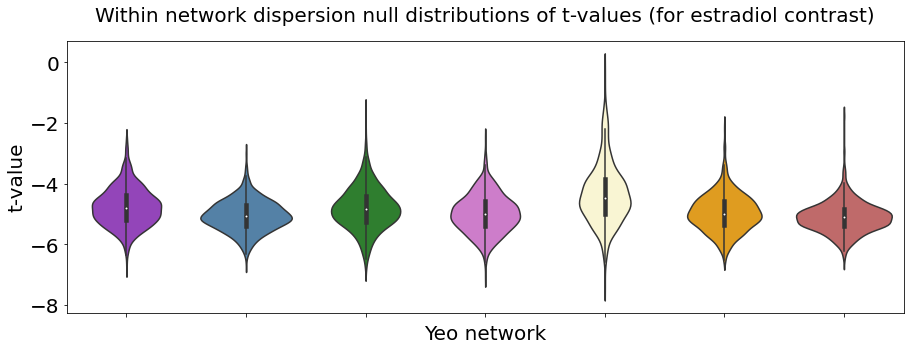

In [190]:
### Violin plot of t-values (null distributions) by Yeo network - in order to show where the empirical t-value is located

WN_dispersion_OC_perm_tval_estradiol_contrast_null_distr = pd.melt(WN_dispersion_OC_perm_tval_estradiol_contrast_null_distr, 
                                                               value_vars = WN_dispersion_OC_perm_tval_estradiol_contrast_null_distr.columns.tolist(), 
                                                               var_name = 'yeo_network', value_name='t_vals', ignore_index=False)

fig, ax = plt.subplots(figsize=(15, 5))


sns.violinplot(data = WN_dispersion_OC_perm_tval_estradiol_contrast_null_distr,
                    x="yeo_network",
                    y="t_vals",
                    #hue="",
                    palette = palette_labeled_networks,
                    split = False)

ax.axes.set_title("Within network dispersion null distributions of t-values (for estradiol contrast)", y=1.05, fontsize=20)
ax.set_xlabel("Yeo network",fontsize=20)
ax.set_ylabel("t-value",fontsize=20)
ax.tick_params(labelsize=20)
ax.set_xticklabels('', rotation=40, ha="right") 
#ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")  # to show tick labels

#plt.show()

# save figure in directory 
plt.savefig(resdir_fig+'violin_WN_dispersion_OC_null_distr_tvals_estradiol.png', dpi=300, bbox_inches="tight")  # bbox_inches is so that the figure doesn't get cut off when savingb

##### Progesterone

In [191]:
# by computing the percentile rank of our empirical t-value relative to the null distribution of t-values obtained via spin permutation (stats.percentileofscore)

spin_p_val = []
sig_post_bonferroni = []


# iterate across networks in order to compare the t-value for a given network to that network's null distribution of tvalues
for network in lmer_WN_dispersion_OC_hormonal_contrast_res.index:
    
    # compute the percentile of our empirical t-value
    percentile_of_tval = stats.percentileofscore(a = WN_dispersion_OC_perm_tval_progesterone_contrast_null_distr[network], score = lmer_WN_dispersion_OC_hormonal_contrast_res.loc[network, 'progesterone_t_val'], kind='mean')/100
    
    
    
    # two-tailed test therefore if our empirical t-value is negative, left tail therefore simply obtain the percentile rank of our t-value
    if lmer_WN_dispersion_OC_hormonal_contrast_res.loc[network, 'progesterone_t_val'] < 0:
        spin_p_val.append(round(percentile_of_tval, 3))
        
        # given that we make 7 comparisons, correct for multiple comparisons with bonferroni (new significance threshold: 0.05/7 = 0.007)
        if percentile_of_tval < 0.05/7:
            sig_post_bonferroni.append('sig')

        else:
            sig_post_bonferroni.append('not sig')
        
        
    
    # if  our empirical t-value is positive, right tail therefore take 1 - the percentile rank of our t-value
    else:
        spin_p_val.append(round(1 - percentile_of_tval, 3))
        
        # given that we make 7 comparisons, correct for multiple comparisons with bonferroni (new significance threshold: 0.05/7 = 0.007)
        if (1 - percentile_of_tval) < 0.05/7:
            sig_post_bonferroni.append('sig')

        else:
            sig_post_bonferroni.append('not sig')
    
    

# add the spin permutation p-value and bonferroni corrected significance to results df
lmer_WN_dispersion_OC_hormonal_contrast_res['progesterone_spin_p_val'] = spin_p_val
lmer_WN_dispersion_OC_hormonal_contrast_res['progesterone Bonferroni sig. (alpha = 0.007)'] = sig_post_bonferroni

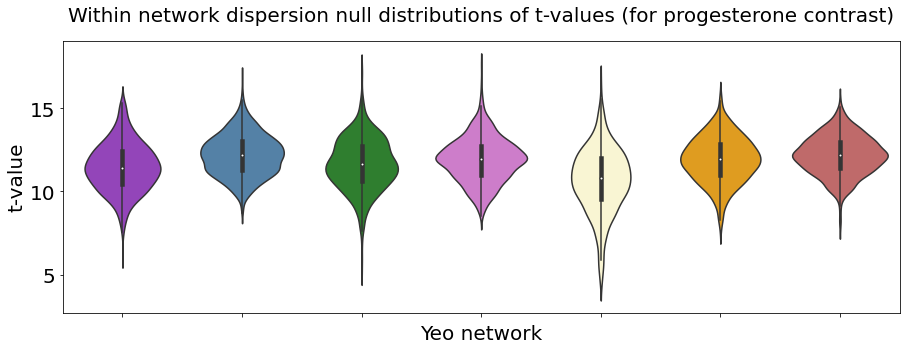

In [192]:
### Violin plot of t-values (null distributions) by Yeo network - in order to show where the empirical t-value is located

WN_dispersion_OC_perm_tval_progesterone_contrast_null_distr = pd.melt(WN_dispersion_OC_perm_tval_progesterone_contrast_null_distr, 
                                                               value_vars = WN_dispersion_OC_perm_tval_progesterone_contrast_null_distr.columns.tolist(), 
                                                               var_name = 'yeo_network', value_name='t_vals', ignore_index=False)

fig, ax = plt.subplots(figsize=(15, 5))


sns.violinplot(data = WN_dispersion_OC_perm_tval_progesterone_contrast_null_distr,
                    x="yeo_network",
                    y="t_vals",
                    #hue="",
                    palette = palette_labeled_networks,
                    split = False)

ax.axes.set_title("Within network dispersion null distributions of t-values (for progesterone contrast)", y=1.05, fontsize=20)
ax.set_xlabel("Yeo network",fontsize=20)
ax.set_ylabel("t-value",fontsize=20)
ax.tick_params(labelsize=20)
ax.set_xticklabels('', rotation=40, ha="right") 
#ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")  # to show tick labels

#plt.show()

# save figure in directory 
plt.savefig(resdir_fig+'violin_WN_dispersion_OC_null_distr_tvals_progesterone.png', dpi=300, bbox_inches="tight")  # bbox_inches is so that the figure doesn't get cut off when savingb

##### Results

In [193]:
lmer_WN_dispersion_OC_hormonal_contrast_res

,estradiol_t_val,estradiol_p_val,progesterone_t_val,progesterone_p_val,estradiol_spin_p_val,estradiol Bonferroni sig. (alpha = 0.007),progesterone_spin_p_val,progesterone Bonferroni sig. (alpha = 0.007)
yeo_network,,,,,,,,
visual,-3.514412,0.000441,6.127117,8.948560e-10,0.960,not sig,1.000,not sig
sensory motor,-0.390460,0.696196,6.313803,2.722608e-10,1.000,not sig,1.000,not sig
dorsal attention,-3.438074,0.000586,7.699521,1.365772e-14,0.967,not sig,0.993,not sig
ventral attention,-0.770019,0.441289,7.454021,9.053756e-14,1.000,not sig,1.000,not sig
limbic,-2.250939,0.024389,5.419861,5.964539e-08,0.953,not sig,0.989,not sig
fronto parietal,-1.375149,0.169085,3.053023,2.265484e-03,1.000,not sig,1.000,not sig
DMN,0.348991,0.727096,3.771603,1.622019e-04,0.000,sig,1.000,not sig


#### Between Network dispersion

In [194]:
# for better readability, rename the columns to the pairwise comparisons with Yeo network labels (instead of numbers)
new_col_names = []

for label in BN_dispersion_OC_perm_tval_estradiol_contrast_null_distr.columns:
    
    n1 = None
    n2 = None
    
    if label[1] == '1':
        n1 = 'visual'
    elif label[1] == '2':
        n1 = 'sensory motor'
    elif label[1] == '3':
        n1 = 'dorsal attention'
    elif label[1] == '4':
        n1 = 'ventral attention'
    elif label[1] == '5':
        n1 = 'limbic'
    elif label[1] == '6':
        n1 = 'fronto parietal'
    elif label[1] == '7':
        n1 = 'DMN'
        
    if label[4] == '1':
        n2 = 'visual'
    elif label[4] == '2':
        n2 = 'sensory motor'
    elif label[4] == '3':
        n2 = 'dorsal attention'
    elif label[4] == '4':
        n2 = 'ventral attention'
    elif label[4] == '5':
        n2 = 'limbic'
    elif label[4] == '6':
        n2 = 'fronto parietal'
    elif label[4] == '7':
        n2 = 'DMN'
        
    new_col_names.append(n1+' - '+n2)    
    
    
BN_dispersion_OC_perm_tval_estradiol_contrast_null_distr.columns = new_col_names
BN_dispersion_OC_perm_tval_progesterone_contrast_null_distr.columns = new_col_names

##### Estradiol

In [195]:
# by computing the percentile rank of our empirical t-value relative to the null distribution of t-values obtained via spin permutation (stats.percentileofscore)

spin_p_val = []
sig_post_bonferroni = []


# iterate across pairwise comparisons in order to compare the t-value for a given pairwise comparison to that pairwise comparison's null distribution of tvalues
for pairwise_comparison in BN_dispersion_OC_hormonal_contrast_res.index:
    
    # compute the percentile of our empirical t-value
    percentile_of_tval = stats.percentileofscore(a = BN_dispersion_OC_perm_tval_estradiol_contrast_null_distr[pairwise_comparison], score = BN_dispersion_OC_hormonal_contrast_res.loc[pairwise_comparison, 'estradiol_t_val'], kind='mean')/100
    
    
    
    # two-tailed test therefore if our empirical t-value is negative, left tail therefore simply obtain the percentile rank of our t-value
    if BN_dispersion_OC_hormonal_contrast_res.loc[pairwise_comparison, 'estradiol_t_val'] < 0:
        spin_p_val.append(round(percentile_of_tval, 3))
        
        # given that we make 21 comparisons, correct for multiple comparisons with bonferroni (new significance threshold: 0.05/21 = 0.002)
        if percentile_of_tval < 0.05/21:
            sig_post_bonferroni.append('sig')

        else:
            sig_post_bonferroni.append('not sig')
        
        
    
    # if  our empirical t-value is positive, right tail therefore take 1 - the percentile rank of our t-value
    else:
        spin_p_val.append(round(1 - percentile_of_tval, 3))
        
        # given that we make 21 comparisons, correct for multiple comparisons with bonferroni (new significance threshold: 0.05/21 = 0.002)
        if (1 - percentile_of_tval) < 0.05/21:
            sig_post_bonferroni.append('sig')

        else:
            sig_post_bonferroni.append('not sig')
    
    

# add the spin permutation p-value and bonferroni corrected significance to results df
BN_dispersion_OC_hormonal_contrast_res['estradiol_spin_p_val'] = spin_p_val
BN_dispersion_OC_hormonal_contrast_res['estradiol Bonferroni sig. (alpha = 0.002)'] = sig_post_bonferroni

##### Progesterone

In [196]:
# by computing the percentile rank of our empirical t-value relative to the null distribution of t-values obtained via spin permutation (stats.percentileofscore)

spin_p_val = []
sig_post_bonferroni = []


# iterate across pairwise comparisons in order to compare the t-value for a given pairwise comparison to that pairwise comparison's null distribution of tvalues
for pairwise_comparison in BN_dispersion_OC_hormonal_contrast_res.index:
    
    # compute the percentile of our empirical t-value
    percentile_of_tval = stats.percentileofscore(a = BN_dispersion_OC_perm_tval_progesterone_contrast_null_distr[pairwise_comparison], score = BN_dispersion_OC_hormonal_contrast_res.loc[pairwise_comparison, 'progesterone_t_val'], kind='mean')/100
    
    
    
    # two-tailed test therefore if our empirical t-value is negative, left tail therefore simply obtain the percentile rank of our t-value
    if BN_dispersion_OC_hormonal_contrast_res.loc[pairwise_comparison, 'progesterone_t_val'] < 0:
        spin_p_val.append(round(percentile_of_tval, 3))
        
        # given that we make 21 comparisons, correct for multiple comparisons with bonferroni (new significance threshold: 0.05/21 = 0.002)
        if percentile_of_tval < 0.05/21:
            sig_post_bonferroni.append('sig')

        else:
            sig_post_bonferroni.append('not sig')
        
        
    
    # if  our empirical t-value is positive, right tail therefore take 1 - the percentile rank of our t-value
    else:
        spin_p_val.append(round(1 - percentile_of_tval, 3))
        
        # given that we make 21 comparisons, correct for multiple comparisons with bonferroni (new significance threshold: 0.05/21 = 0.002)
        if (1 - percentile_of_tval) < 0.05/21:
            sig_post_bonferroni.append('sig')

        else:
            sig_post_bonferroni.append('not sig')
    
    

# add the spin permutation p-value and bonferroni corrected significance to results df
BN_dispersion_OC_hormonal_contrast_res['progesterone_spin_p_val'] = spin_p_val
BN_dispersion_OC_hormonal_contrast_res['progesterone Bonferroni sig. (alpha = 0.002)'] = sig_post_bonferroni

In [197]:
BN_dispersion_OC_hormonal_contrast_res

,estradiol_t_val,estradiol_p_val,progesterone_t_val,progesterone_p_val,estradiol_spin_p_val,estradiol Bonferroni sig. (alpha = 0.002),progesterone_spin_p_val,progesterone Bonferroni sig. (alpha = 0.002)
pairwise_comparisons,,,,,,,,
visual - sensory motor,4.965711,6.844996e-07,-12.906962,4.112070e-38,0.021,not sig,0.001,sig
visual - dorsal attention,-1.979258,4.778699e-02,6.111973,9.840690e-10,0.299,not sig,0.205,not sig
visual - ventral attention,3.368190,7.566331e-04,-9.270815,1.847288e-20,0.119,not sig,0.035,not sig
visual - limbic,-2.689511,7.155689e-03,4.921940,8.569028e-07,0.233,not sig,0.319,not sig
visual - fronto parietal,-3.536723,4.051239e-04,9.877307,5.221719e-23,0.165,not sig,0.069,not sig
visual - DMN,-3.620811,2.936813e-04,10.687597,1.163463e-26,0.158,not sig,0.052,not sig
sensory motor - dorsal attention,-5.752045,8.817015e-09,15.343627,3.907404e-53,0.007,not sig,0.000,sig
sensory motor - ventral attention,-2.161967,3.062072e-02,5.451320,4.999739e-08,0.231,not sig,0.157,not sig
sensory motor - limbic,-5.527086,3.255928e-08,13.174717,1.226861e-39,0.027,not sig,0.010,not sig
